# Part 1: Preparing

In [ ]:
!pip install optuna

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
! pip install category_encoders

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
! pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import numpy as np
import scipy
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
import lightgbm as lgb
import optuna
import ast
import re
import plotly.express as px
import folium
from branca.colormap import linear
"""from google.colab import drive
drive.mount('/content/drive')"""

"from google.colab import drive\ndrive.mount('/content/drive')"

In [ ]:
# Optional configuration

# This is to clear the warnings from the notebook, usually we should leave this on
import warnings
warnings.filterwarnings('ignore')

# Plot settings
sns.set_context('notebook') # optimises figures for notebook display
sns.set_style('ticks') # set default plot style
colours = ['#4E79A7','#F28E2C','#E15759','#76B7B2','#59A14F',
          '#EDC949','#AF7AA1','#FF9DA7','#9C755F','#BAB0AB']
sns.set_palette(colours) # set custom color scheme

%matplotlib inline
plt.rcParams['figure.figsize'] = (9, 6)
plt.rcParams['figure.dpi'] = 80
%config InlineBackend.figure_format = 'retina'

In [ ]:
dataOrigin = pd.read_csv('6810.csv')

In [ ]:
dataOrigin.shape

(22100, 75)

# Part2: Data Preprocessing

In [ ]:
dataOrigin = dataOrigin.drop(['calendar_updated', 'neighbourhood_group_cleansed', 'host_about','description','name','host_thumbnail_url','host_name','host_has_profile_pic','number_of_reviews_ltm','host_url','host_id','picture_url',
                       'source','scrape_id','calendar_last_scraped','availability_60','availability_90','listing_url','amenities','availability_30','id','host_verifications', 'host_picture_url','amenities','neighborhood_overview',
                       ],axis=1)

In [ ]:
data = dataOrigin.drop(['bathrooms','bedrooms','neighbourhood'],axis = 1)
# bathrooms replace by bathrooms_text; bedrooms vs beds; neighbourhood vs host_location

In [ ]:
data_und_2 = dataOrigin.isnull().sum().sort_values(ascending=False)
variable_names_2 = data_und_2.index.tolist()
data_types_2 = dataOrigin.dtypes[variable_names_2]

data_und_2 = pd.DataFrame({'Missing Count': data_und_2, 'Data Type': data_types_2})
pd.set_option('display.max_rows', 500)
data_und_2

,Missing Count,Data Type
bathrooms,22100,float64
host_acceptance_rate,11465,object
host_response_time,11432,object
host_response_rate,11432,object
license,11361,object
host_neighbourhood,10992,object
neighbourhood,9371,object
review_scores_value,6699,float64
review_scores_checkin,6698,float64
review_scores_location,6696,float64


In [ ]:
'''data = dataOrigin[['neighbourhood','review_scores_value','host_location','reviews_per_month',
             'review_scores_rating','bedrooms','description','beds','room_type','number_of_reviews',
             'instant_bookable','accommodates','price','amenities',
             'minimum_minimum_nights','minimum_nights','availability_365','longitude','latitude','last_review','license','host_acceptance_rate','host_response_rate','host_response_time','bathrooms_text']]
print(data.columns.duplicated().any())'''

"data = dataOrigin[['neighbourhood','review_scores_value','host_location','reviews_per_month',\n             'review_scores_rating','bedrooms','description','beds','room_type','number_of_reviews',\n             'instant_bookable','accommodates','price','amenities',\n             'minimum_minimum_nights','minimum_nights','availability_365','longitude','latitude','last_review','license','host_acceptance_rate','host_response_rate','host_response_time','bathrooms_text']]\nprint(data.columns.duplicated().any())"

## Missing Value

### Variables: acceptance rate & response time & response rate

In [ ]:
data['host_response_time'] = data['host_response_time'].fillna('NotProvided')

In [ ]:
data['host_acceptance_rate'] = data['host_acceptance_rate'].str.rstrip('%').astype(float)

# Define the replacement categories and their corresponding ranges
categories = {
    'NotProvided': pd.isnull,
    'low': lambda x: 0 <= x <= 50,
    'medium': lambda x: 50 < x <= 75,
    'high': lambda x: 75 < x <= 100
}
# Replace values based on the defined categories
data['host_acceptance_rate'] = data['host_acceptance_rate'].apply(lambda x: next((category for category, condition in categories.items() if condition(x)), x))

In [ ]:
data['host_response_rate'] = data['host_response_rate'].str.rstrip('%').astype(float)

# Replace values based on the defined categories
data['host_response_rate'] = data['host_response_rate'].apply(lambda x: next((category for category, condition in categories.items() if condition(x)), x))

### Variables: license

In [ ]:
# Replace missing values with 'NotProvided'
data['license'] = data['license'].fillna('NotProvided')

# Replace values based on the conditions
data['license'] = np.where(data['license'].str.startswith('PID-STRA'), 'PID-STRA',
                           np.where(data['license'] == 'NotProvided', 'NotProvided', 'Exxmpt&Others'))

In [ ]:
data['license'].value_counts().sort_index()

Exxmpt&Others     1689
NotProvided      11361
PID-STRA          9050
Name: license, dtype: int64

### Variables: neighborhood

In [ ]:
data['host_neighbourhood'] = data['host_neighbourhood'].fillna('NotProvided')

### Variables: Review

In [ ]:
# Define the replacement categories and their corresponding ranges
categories = {
    'NotProvided': pd.isnull,
    'low': lambda x: 0 <= x <= 3,
    'medium': lambda x: 3 < x <= 4,
    'high': lambda x: 4 < x <= 5
}


data_columns = ['review_scores_value', 'review_scores_location', 'review_scores_accuracy',
                'review_scores_communication', 'review_scores_cleanliness', 'review_scores_rating','review_scores_checkin']

for column in data_columns:
    data[column] = data[column].apply(lambda x: next((category for category, condition in categories.items() if condition(x)), x))

In [ ]:
data['reviews_per_month'] = data['reviews_per_month'].fillna('NotProvided')

### Variables: Location

In [ ]:
data['host_location'] = data['host_location'].fillna('NotProvided')

### Variables: beds & bathroom

In [ ]:
# Convert 'bathrooms_text' column to string
data['bathrooms_text'] = data['bathrooms_text'].astype(str)

# Remove unwanted words from the 'bathrooms_text' column
data['bathrooms_text'] = data['bathrooms_text'].str.replace(r'(shared|Shared)', '', regex=True)
data['bathrooms_text'] = data['bathrooms_text'].str.extract(r'(\d+\.?\d*)', expand=False).astype(float)

# Create the 'shared_bath' column based on the presence of 'shared'
data['shared_bath'] = data['bathrooms_text'].apply(lambda x: 1 if pd.notnull(x) and x.is_integer() else 0)

In [ ]:
data['bathrooms_text'].value_counts().sort_index()

0.0        78
1.0     14499
1.5      1295
2.0      3921
2.5       786
3.0       848
3.5       251
4.0       204
4.5        60
5.0        48
5.5        19
6.0        13
6.5         3
7.0         4
7.5         1
11.0        1
Name: bathrooms_text, dtype: int64

In [ ]:
data['shared_bath'].value_counts().sort_index()

0     2484
1    19616
Name: shared_bath, dtype: int64

## Data Types

In [ ]:
data['host_is_superhost']=(data['host_is_superhost'] =='t').astype(int)
data['host_identity_verified']=(data['host_identity_verified'] =='t').astype(int)

In [ ]:
# Variable: 'minimum_minimum_nights'
# Convert 'minimum_minimum_nights' column to numeric values, non-numeric values will become NaN
data['minimum_minimum_nights'] = pd.to_numeric(data['minimum_minimum_nights'], errors='coerce')

# Calculate the median of numeric values
median_val = data['minimum_minimum_nights'].median()

# Replace non-numeric values with the median
data['minimum_minimum_nights'].fillna(median_val, inplace=True)

# Convert the column to int64
data['minimum_minimum_nights'] = data['minimum_minimum_nights'].astype(np.int64)


In [ ]:
data["price"] = data["price"].str.replace(',', '').str.replace('$', '').astype(float)

In [ ]:
date_columns = ['last_scraped', 'host_since', 'first_review', 'last_review']

# Convert the specified date columns to datetime data type
data[date_columns] = data[date_columns].apply(pd.to_datetime)

# Calculate the days difference for each date column
for column in date_columns[1:]:
    data[column] = (data['last_scraped'] - data[column]).dt.days
    data.loc[data['last_scraped'].isnull() | data[column].isnull(), column] = np.nan
    data[column] = data[column].astype(pd.Int64Dtype())

data= data.drop(['last_scraped'],axis=1)

# Define the replacement categories and their corresponding ranges
categories = {
    'NotProvided': pd.isnull,
    '2': lambda x: 0 <= x <= 730,
    '2to4': lambda x: 730 < x <= 1460,
    '4to6': lambda x: 1460 < x <= 2190,
    '6to11': lambda x: 2190 < x <= 4028
}
# Replace values based on the defined categories
data['last_review'] = data['last_review'].apply(lambda x: next((category for category, condition in categories.items() if condition(x)), x))

data['first_review'] = data['first_review'].apply(lambda x: next((category for category, condition in categories.items() if condition(x)), x))



In [ ]:
category_counts = data['property_type'].value_counts()

categories_to_group = category_counts[category_counts < 100].index


grouped_category = 'Other'

data.loc[data['property_type'].isin(categories_to_group), 'property_type'] = grouped_category

## Fill missing value

In [ ]:
from sklearn.model_selection import train_test_split

index_train, index_valid = train_test_split(data.index, train_size=0.7, random_state=42)

train = data.loc[index_train, :].copy()
valid = data.loc[index_valid, :].copy()

y_train = train['price']
y_valid = valid['price']

In [ ]:
X_train = train.drop('price', axis=1)
X_valid = valid.drop('price', axis=1)

In [ ]:
print (y_train.shape)
print (y_valid.shape)
print (X_train.shape)
print (X_valid.shape)

(15469,)
(6631,)
(15469, 47)
(6631, 47)


In [ ]:
# Create a list to store variables with more than 0 missing values
missing_variables = []

# Find variables with more than 4000 missing values
for variable in X_train.columns:
    if X_train[variable].isnull().sum() > 0:
        missing_variables.append(variable)

In [ ]:
missing_variables

['host_since',
 'host_listings_count',
 'host_total_listings_count',
 'bathrooms_text',
 'beds']

In [ ]:
missing_variables_correlations = {}

for variable in missing_variables:
    correlations = X_train.corr()[variable].abs().sort_values(ascending=False).head(5).round(2)
    correlated_variables = correlations.index.tolist()[1:]  # Exclude the variable itself from the list
    missing_variables_correlations[variable] = correlated_variables


In [ ]:
print(missing_variables_correlations)

{'host_since': ['longitude', 'availability_365', 'minimum_minimum_nights', 'minimum_nights_avg_ntm'], 'host_listings_count': ['host_total_listings_count', 'calculated_host_listings_count_entire_homes', 'calculated_host_listings_count', 'availability_365'], 'host_total_listings_count': ['host_listings_count', 'calculated_host_listings_count_entire_homes', 'calculated_host_listings_count', 'availability_365'], 'bathrooms_text': ['accommodates', 'beds', 'shared_bath', 'latitude'], 'beds': ['accommodates', 'bathrooms_text', 'shared_bath', 'latitude']}


In [ ]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
imputer = IterativeImputer()

for variable, correlated_variables in missing_variables_correlations.items():
    predictors = [variable] + correlated_variables
    X_train_impute = X_train[predictors]
    imputer.fit(X_train_impute)
    X_train[predictors] = imputer.transform(X_train[predictors])
    X_valid[predictors] = imputer.transform(X_valid[predictors])
    data[predictors] = imputer.transform(data[predictors])

## Check

In [ ]:
data_check = data.isnull().sum().sort_values(ascending=False)
variable_check = data_check.index.tolist()
data_types_ch = data.dtypes[variable_check]

data_check = pd.DataFrame({'Missing Count': data_check, 'Data Type': data_types_ch})
pd.set_option('display.max_rows', 500)
data_check

,Missing Count,Data Type
host_since,0,float64
host_location,0,object
maximum_nights_avg_ntm,0,float64
has_availability,0,object
availability_365,0,float64
number_of_reviews,0,int64
number_of_reviews_l30d,0,int64
first_review,0,object
last_review,0,object
review_scores_rating,0,object


# Part 3: Data Visualization

In [ ]:
pd.set_option('display.max_columns', None)
data.describe(include='all')

,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_total_listings_count,host_identity_verified,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,beds,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_365,number_of_reviews,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,shared_bath
count,22100.000000,22100,22100,22100,22100,22100.000000,22100,22100.000000,22100.000000,22100.000000,22100,22100.000000,22100.000000,22100,22100,22100.000000,22100.000000,22100.000000,22100.000000,22100.000000,22100.000000,22100.000000,22100.000000,2.210000e+04,2.210000e+04,22100.000000,2.210000e+04,22100,22100.000000,22100.000000,22100.000000,22100,22100,22100,22100,22100,22100,22100,22100,22100,22100,22100,22100.000000,22100.000000,22100.000000,22100.000000,22100,22100.000000
unique,NaN,1060,5,4,4,NaN,207,NaN,NaN,NaN,38,NaN,NaN,18,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,18,5,4,4,4,4,4,4,4,3,2,NaN,NaN,NaN,NaN,654,NaN
top,NaN,NotProvided,NotProvided,NotProvided,NotProvided,NaN,NotProvided,NaN,NaN,NaN,Sydney,NaN,NaN,Entire rental unit,Entire home/apt,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,NaN,NaN,NaN,NotProvided,2,high,high,high,high,high,high,high,NotProvided,f,NaN,NaN,NaN,NaN,NotProvided,NaN
freq,NaN,5863,11432,11432,11465,NaN,10992,NaN,NaN,NaN,4922,NaN,NaN,8691,15235,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21962,NaN,NaN,NaN,6138,8525,13809,14190,13278,14620,14598,14634,13679,11361,15201,NaN,NaN,NaN,NaN,6138,NaN
mean,2378.389463,NaN,NaN,NaN,NaN,0.119729,NaN,18.054517,32.844596,0.821991,NaN,-33.856682,151.196413,NaN,NaN,3.566290,1.418643,2.101333,322.254349,53.436606,812.515928,52.654434,55.578914,3.895641e+05,1.361292e+06,54.426674,1.081166e+06,NaN,100.163303,20.211946,0.511765,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.580362,9.094208,1.419412,0.043303,NaN,0.887602
std,914.176081,NaN,NaN,NaN,NaN,0.324651,NaN,79.713779,139.539934,0.382529,NaN,0.082819,0.096882,NaN,NaN,2.283217,0.725377,1.520533,972.621442,53.572724,443.161576,52.654135,61.287111,2.888910e+07,5.403433e+07,57.646962,4.487665e+07,NaN,126.555765,47.838680,1.292366,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30.624311,28.907512,9.450827,0.560457,NaN,0.315863
min,3.000000,NaN,NaN,NaN,NaN,0.000000,NaN,1.000000,1.000000,0.000000,NaN,-34.100680,150.630490,NaN,NaN,1.000000,0.000000,0.505244,12.000000,1.000000,1.000000,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,NaN,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,0.000000,0.000000,0.000000,NaN,0.000000
25%,1776.750000,NaN,NaN,NaN,NaN,0.000000,NaN,1.000000,1.000000,1.000000,NaN,-33.898473,151.168313,NaN,NaN,2.000000,1.000000,1.000000,93.000000,3.000000,365.000000,2.000000,5.000000,3.650000e+02,3.650000e+02,3.000000,3.650000e+02,NaN,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,0.000000,0.000000,0.000000,NaN,1.000000
50%,2494.000000,NaN,NaN,NaN,NaN,0.000000,NaN,1.000000,2.000000,1.000000,NaN,-33.880145,151.214110,NaN,NaN,3.000000,1.000000,2.000000,172.000000,90.000000,1125.000000,90.000000,90.000000,1.125000e+03,1.125000e+03,90.000000,1.125000e+03,NaN,32.000000,3.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,0.000000,0.000000,NaN,1.000000
75%,3015.000000,NaN,NaN,NaN,NaN,0.000000,NaN,4.000000,6.000000,1.000000,NaN,-33.818575,151.26

## Price

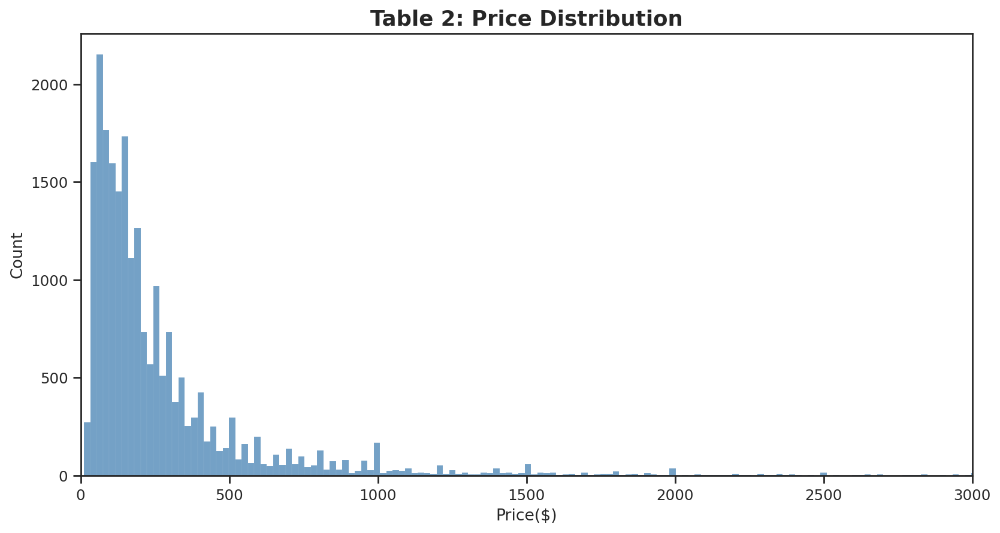

In [ ]:
plt.figure(figsize=(12, 6))
sns.histplot(data['price'], bins=3000,color = 'SteelBlue')
plt.xlim(0, 3000)
plt.title('Table 2: Price Distribution', fontsize=16, fontweight='bold')
plt.xlabel('Price($)',fontsize=12)
plt.ylabel('Count', fontsize=12)

plt.show()

In [ ]:
var_price = data['price']
log_price = np.log(var_price)
log_price = log_price.round(2)

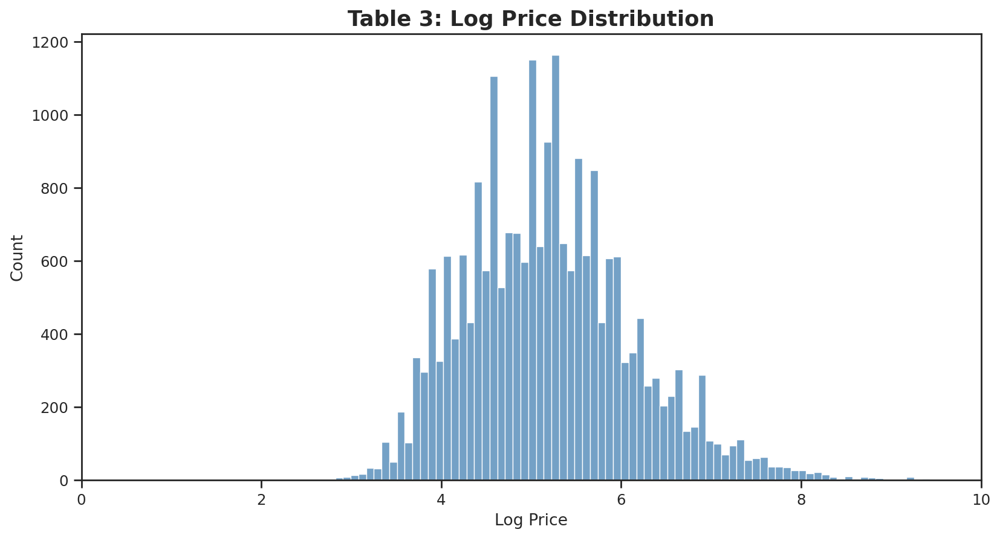

In [ ]:
plt.figure(figsize=(12, 6))
sns.histplot(log_price, bins=100,color = 'SteelBlue')
plt.xlim(0, 10)
plt.title('Table 3: Log Price Distribution', fontsize=16, fontweight='bold')
plt.xlabel('Log Price',fontsize=12)
plt.ylabel('Count', fontsize=12)

plt.show()

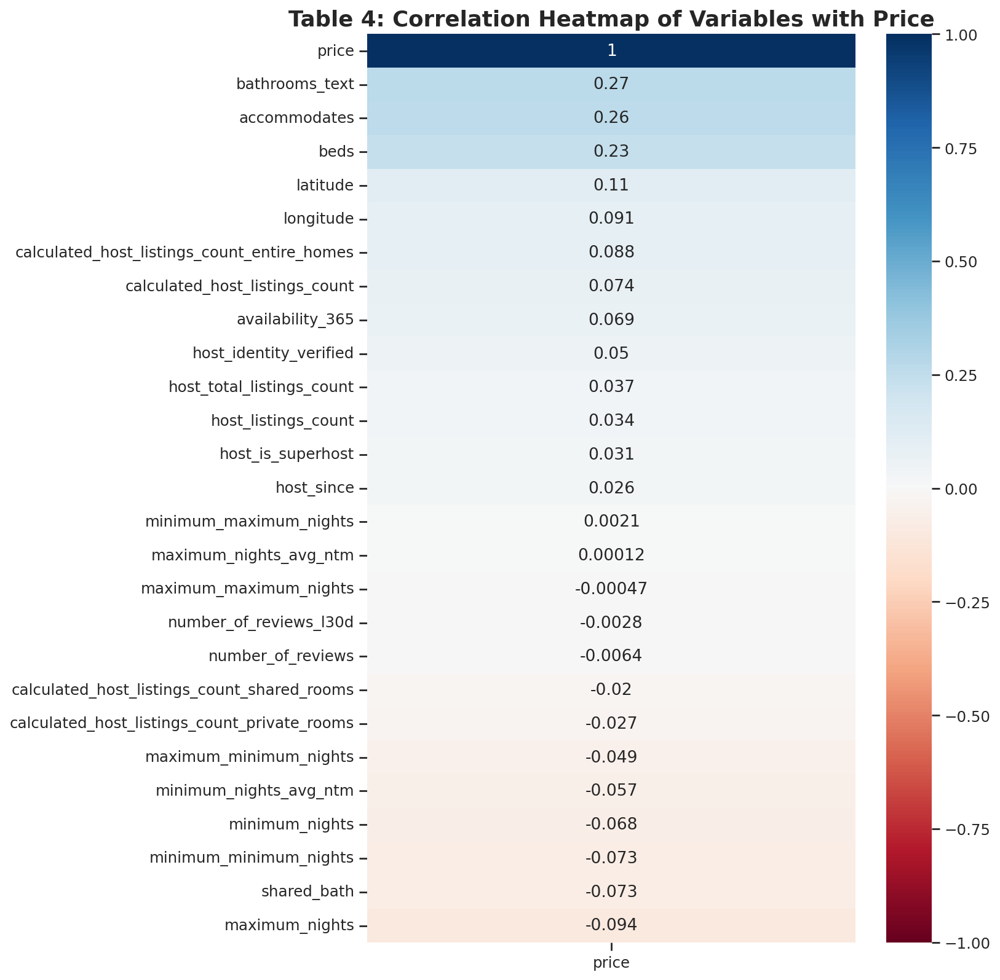

In [ ]:
corr_matrix = data.corr()[['price']]
sorted_corr_matrix = corr_matrix.sort_values(by='price', ascending=False)
plt.figure(figsize=(8, 12))
sns.heatmap(sorted_corr_matrix, annot=True, cmap='RdBu', center=0, vmin=-1, vmax=1)
plt.title('Table 4: Correlation Heatmap of Variables with Price', fontsize=16, fontweight='bold')
plt.show()

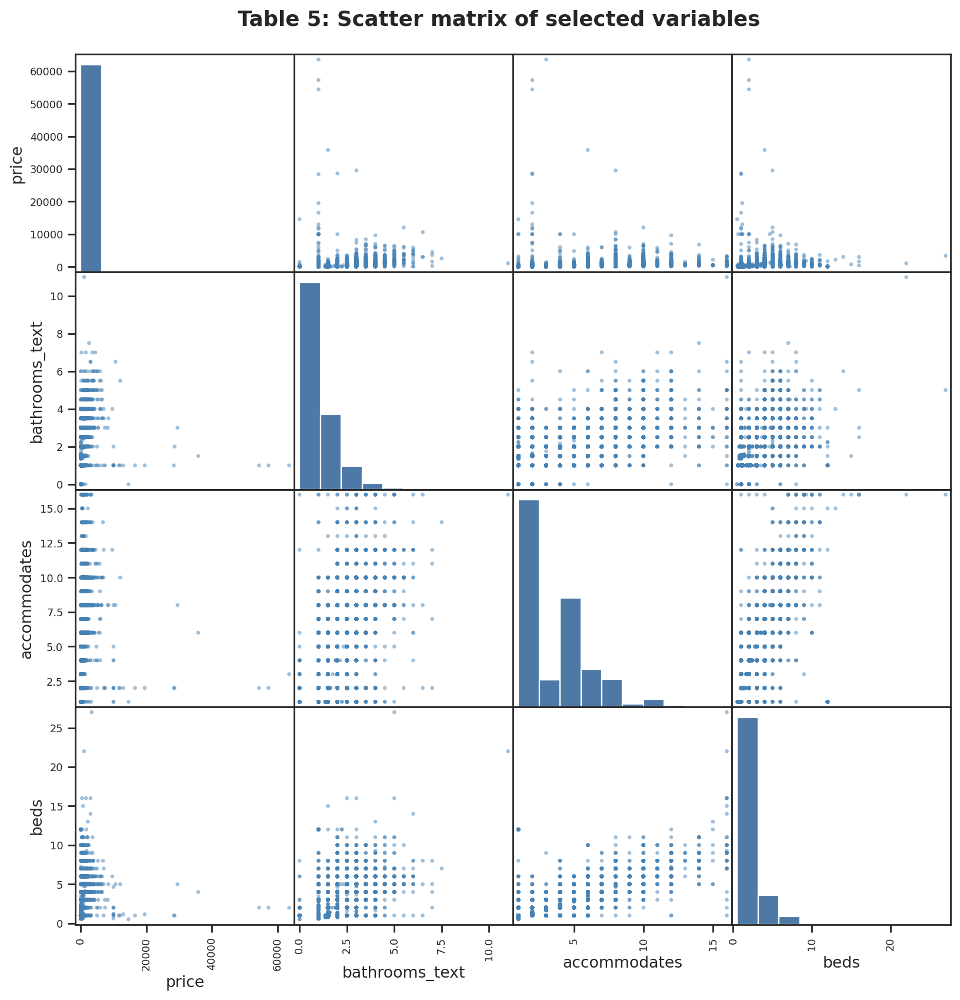

In [ ]:
from pandas.plotting import scatter_matrix

scattercols = ['price', 'bathrooms_text', 'accommodates','beds']
axs = scatter_matrix(data[scattercols],figsize=(12, 12), c='SteelBlue')

plt.suptitle('Table 5: Scatter matrix of selected variables', fontsize=16, fontweight='bold', y=0.92)
plt.show()

## Bathroom

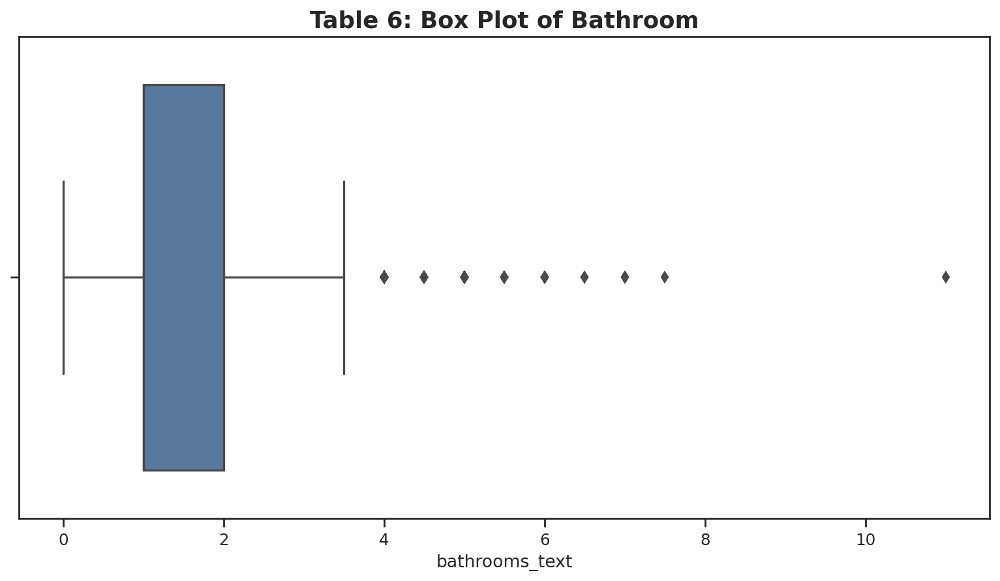

In [ ]:
data['bathrooms_text'].value_counts().sort_index()
plt.figure(figsize=(12,6))
sns.boxplot(x='bathrooms_text', data=data)
plt.title('Table 6: Box Plot of Bathroom', fontsize=16, fontweight='bold')
plt.show()

0.0     2484
1.0    19616
Name: shared_bath, dtype: int64


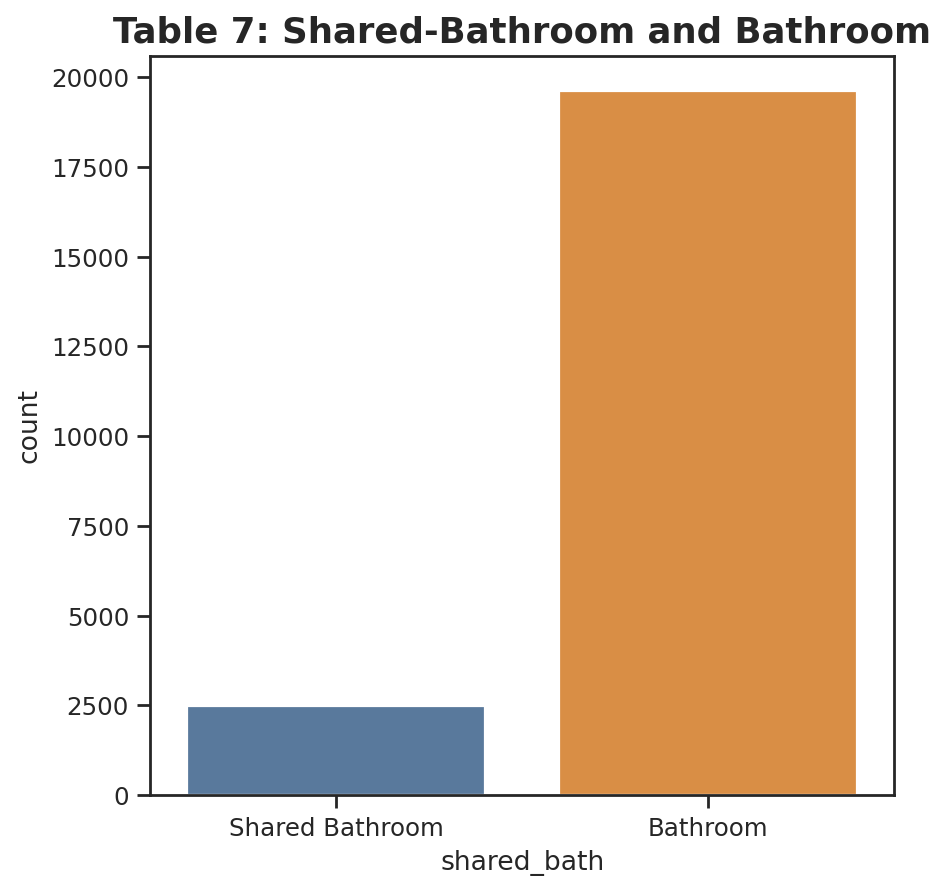

In [ ]:
plt.figure(figsize=(6, 6))
data['shared_bath'].value_counts().sort_index()

sns.countplot(x='shared_bath', data=data, )
plt.title('Table 7: Shared-Bathroom and Bathroom', fontsize=16, fontweight='bold')
plt.gca().set_xticklabels(['Shared Bathroom', 'Bathroom'])
#plt.legend(data['shared_bath'])
print(data['shared_bath'].value_counts().sort_index())

## Bed

2.1013333648711345


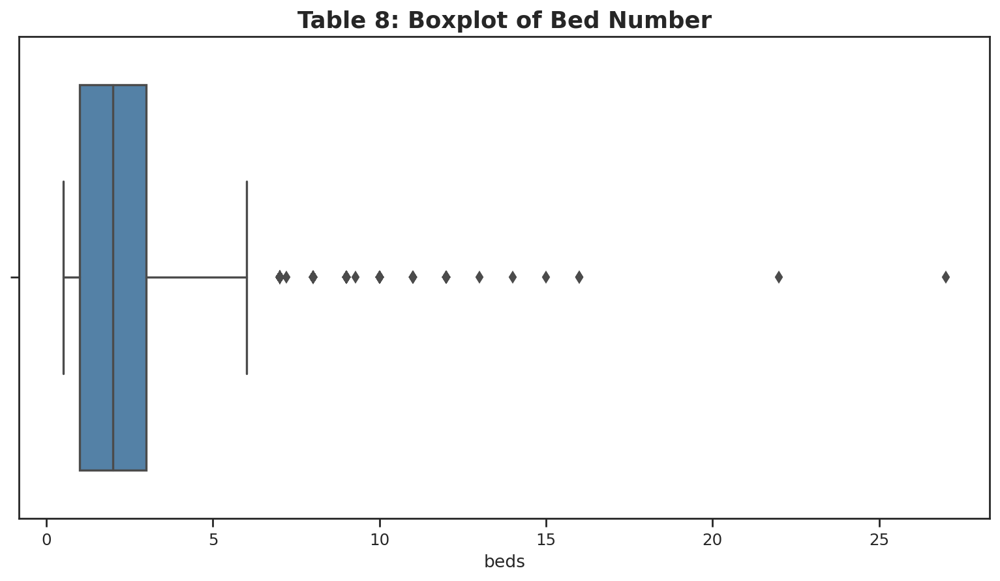

In [ ]:
beds = data["beds"].value_counts()
plt.figure(figsize=(12, 6))
sns.boxplot(x='beds', data=data, color='SteelBlue')
plt.title('Table 8: Boxplot of Bed Number', fontsize=16, fontweight='bold')
print(data["beds"].mean())
plt.show()

## Location

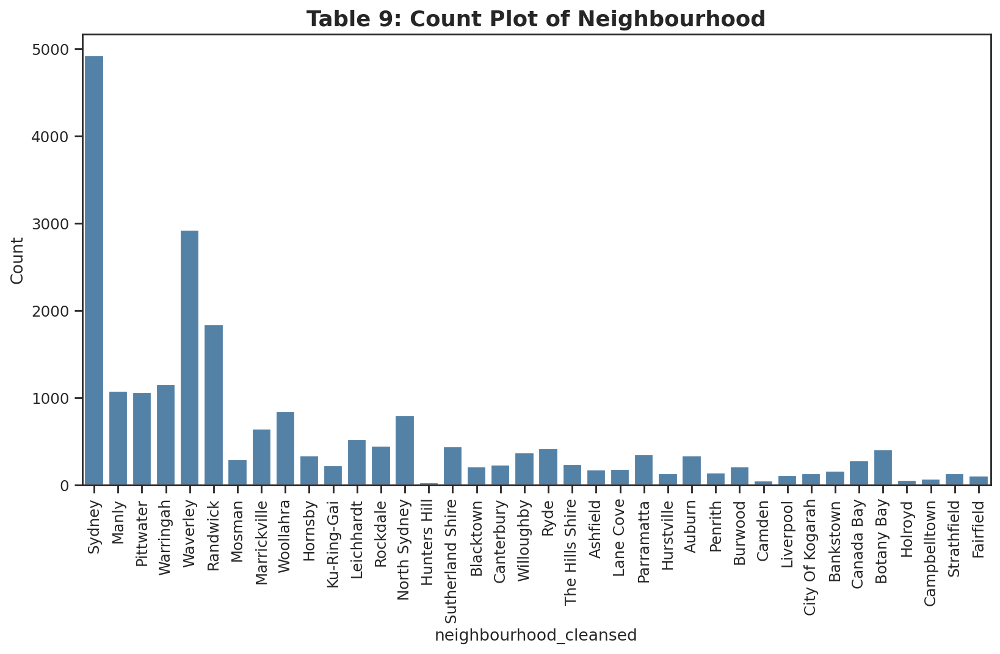

In [ ]:
plt.figure(figsize=(12, 6))
sns.countplot(data=data, x='neighbourhood_cleansed', color='steelblue')
plt.title('Table 9: Count Plot of Neighbourhood', fontsize=16, fontweight='bold')
plt.xlabel('neighbourhood_cleansed')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

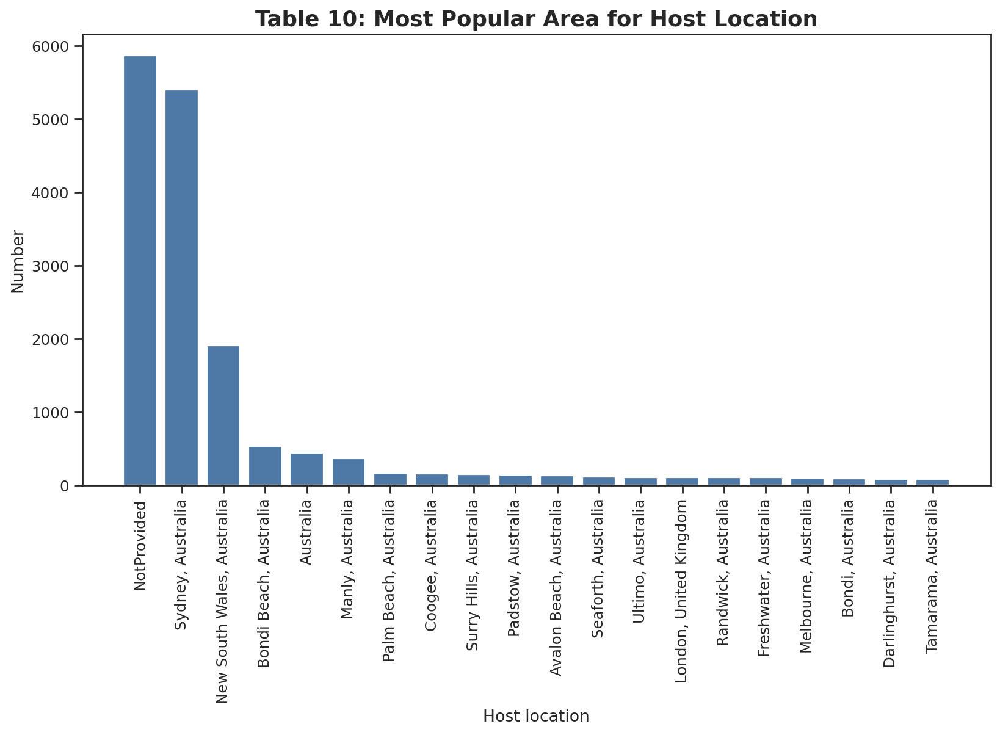

In [ ]:
plt.figure(figsize=(12, 6))
data['host_location'] = data['host_location'].fillna('NotProvided')
areact = data['host_location'].value_counts()
top10_location = areact.head(20)
plt.bar(top10_location.index, top10_location)
plt.xlabel('Host location')
plt.ylabel('Number')
plt.title("Table 10: Most Popular Area for Host Location", fontsize=16, fontweight='bold')
plt.xticks(rotation=90)

plt.show()

## Property Type

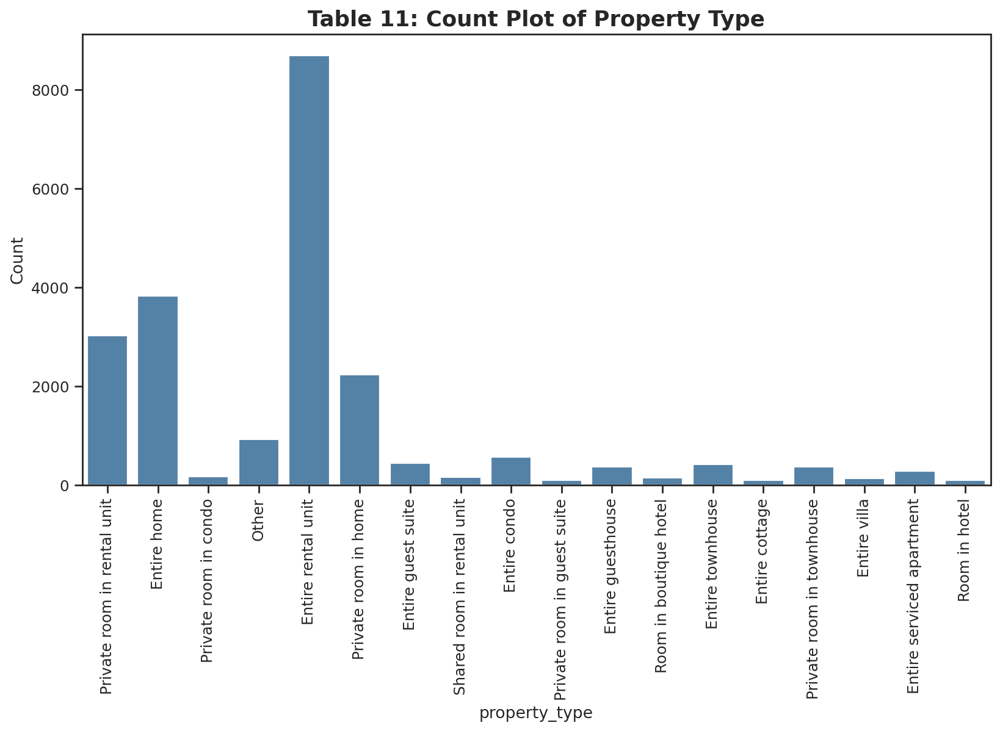

In [ ]:
plt.figure(figsize=(12, 6))
sns.countplot(data=data, x='property_type', color='steelblue')
plt.title('Table 11: Count Plot of Property Type', fontsize=16, fontweight='bold')
plt.xlabel('property_type')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

## Room Types

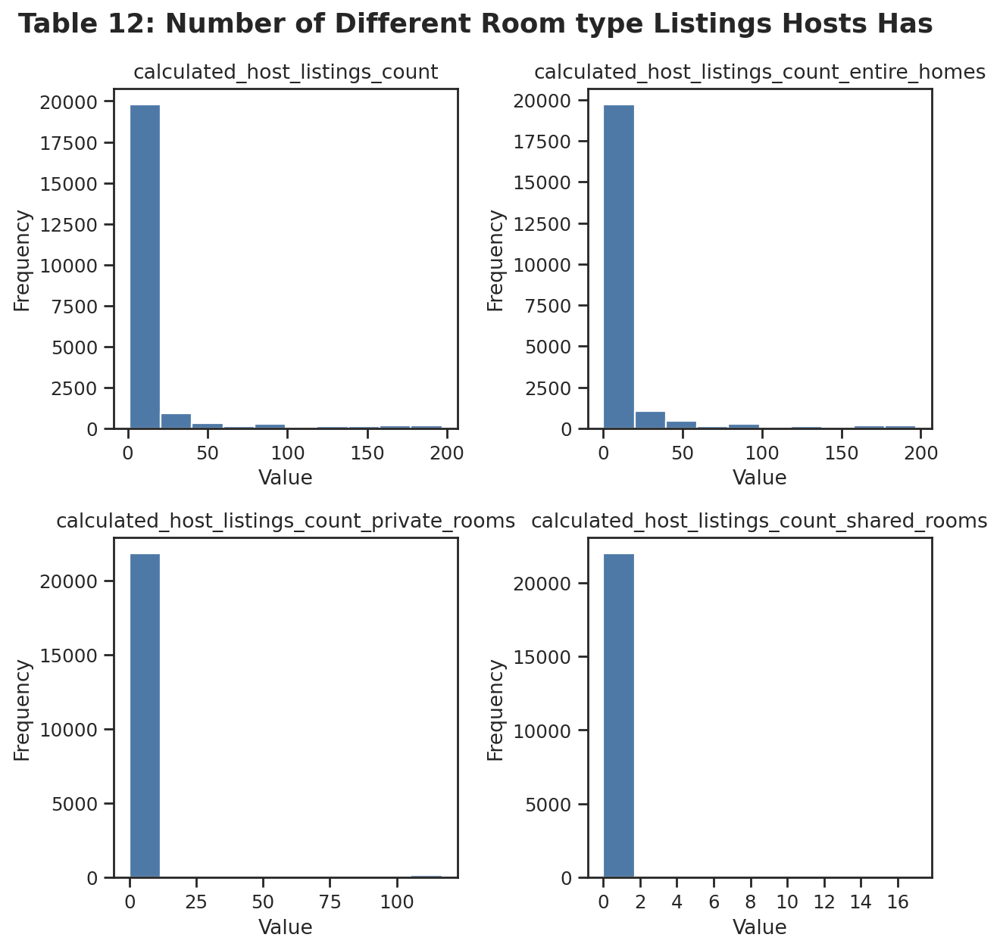

In [ ]:
# List of variables
var_calculated = ['calculated_host_listings_count', 'calculated_host_listings_count_entire_homes',
             'calculated_host_listings_count_private_rooms', 'calculated_host_listings_count_shared_rooms']

# Create a grid layout
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 8))

# Generate histograms
for i, var in enumerate(var_calculated):
    row = i // 2
    col = i % 2

    if var != 'calculated_host_listings_count_shared_rooms':
        axes[row, col].hist(data[var], bins=10)
        axes[row, col].set_title(var)
        axes[row, col].set_xlabel('Value')
        axes[row, col].set_ylabel('Frequency')
    else:
        axes[row, col].hist(data[var], bins=10)
        axes[row, col].set_title(var)
        axes[row, col].set_xlabel('Value')
        axes[row, col].set_ylabel('Frequency')
        axes[row, col].xaxis.set_major_locator(plt.MaxNLocator(integer=True))

plt.suptitle('Table 12: Number of Different Room type Listings Hosts Has', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

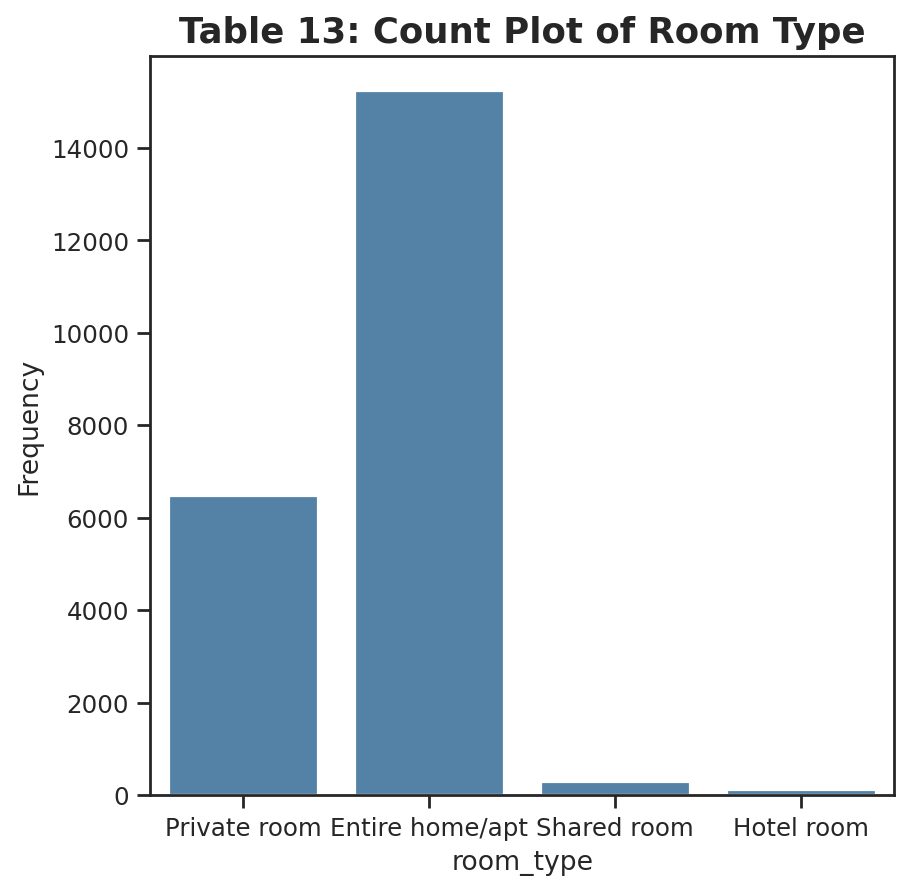

<Figure size 720x480 with 0 Axes>

In [ ]:
plt.figure(figsize=(6, 6))
sns.countplot(data=dataOrigin, x='room_type', color='steelblue')
plt.title('Bar Chart of room_type', fontsize=16, fontweight='bold')
plt.xlabel('room_type')
plt.ylabel('Frequency')
plt.xticks()
plt.title('Table 13: Count Plot of Room Type', fontsize=16, fontweight='bold')
plt.show()
plt.savefig('barchart_room_type.png')


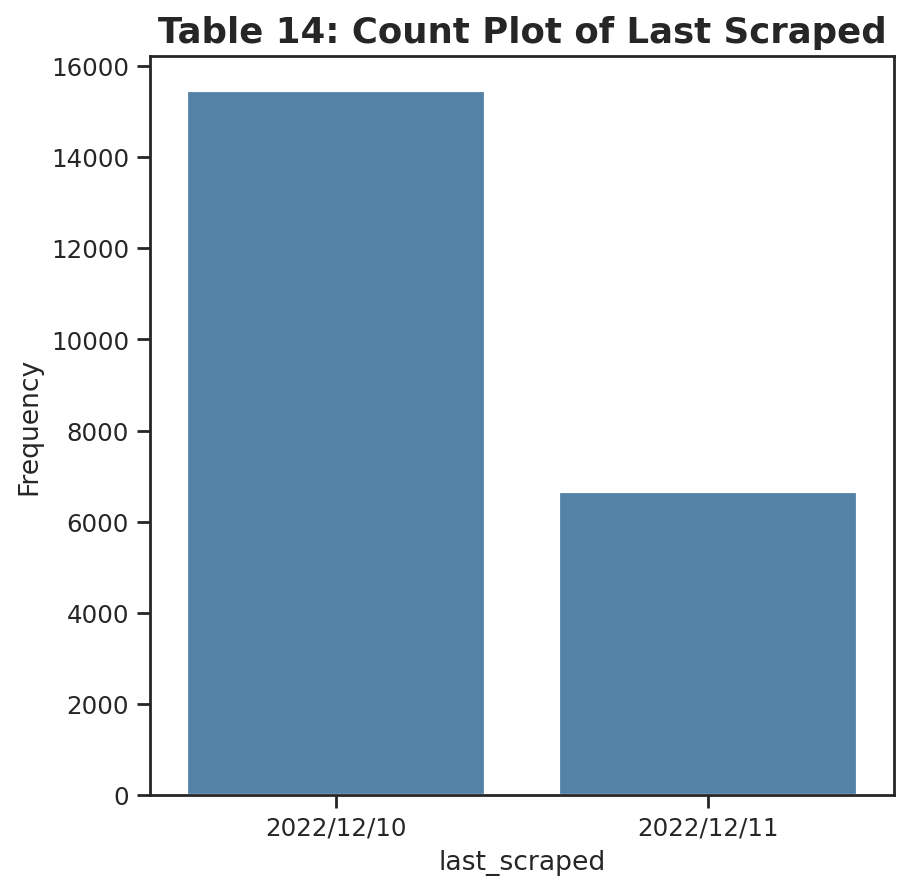

<Figure size 720x480 with 0 Axes>

In [ ]:
plt.figure(figsize=(6, 6))
sns.countplot(data=dataOrigin, x='last_scraped', color='steelblue')
plt.title('Bar Chart of last_scraped', fontsize=16, fontweight='bold')
plt.xlabel('last_scraped')
plt.ylabel('Frequency')
plt.title('Table 14: Count Plot of Last Scraped', fontsize=16, fontweight='bold')
plt.show()
plt.savefig('barchart_last_scraped.png')


In [ ]:
data['log_price']=np.log(data['price'])

## Host Acceptance Rate

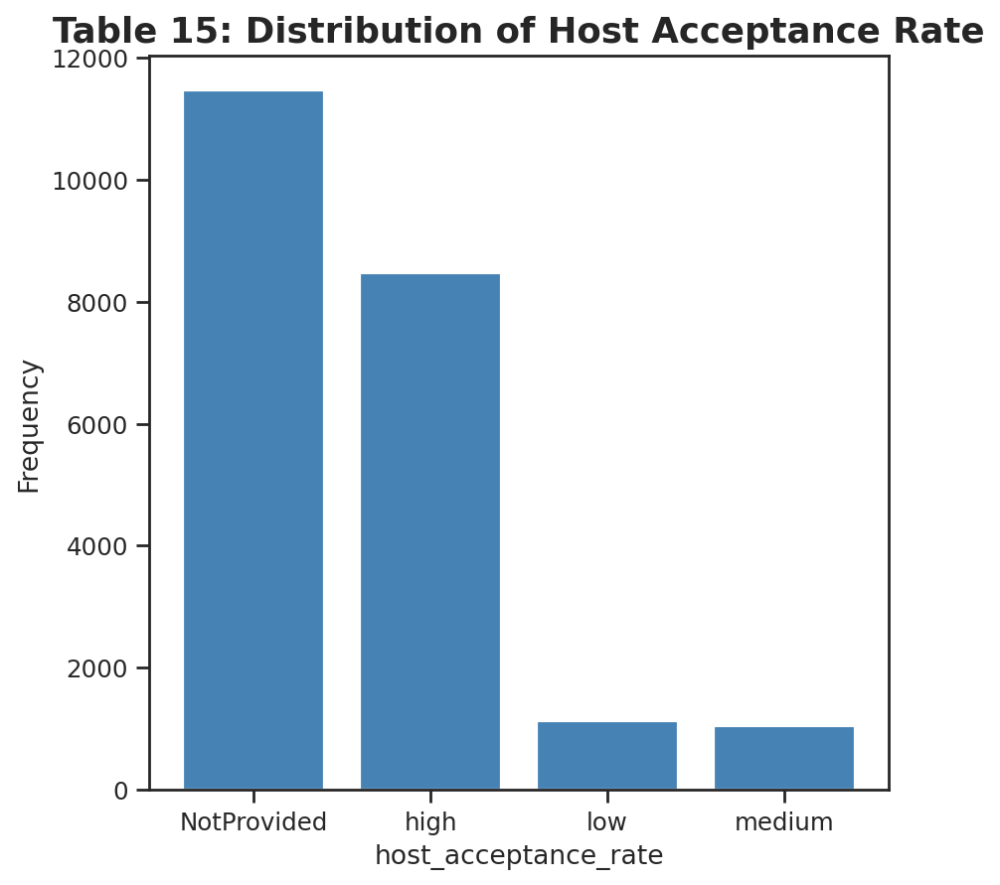

In [ ]:
# Calculate the frequency of each category
category_counts = data['host_acceptance_rate'].value_counts()

# Plot the histogram
plt.figure(figsize=(6, 6))
plt.bar(category_counts.index, category_counts.values,color='steelblue')
plt.xlabel('host_acceptance_rate')
plt.ylabel('Frequency')
plt.title('Table 15: Distribution of Host Acceptance Rate', fontsize=16, fontweight='bold')
plt.show()

## Host Response Rate

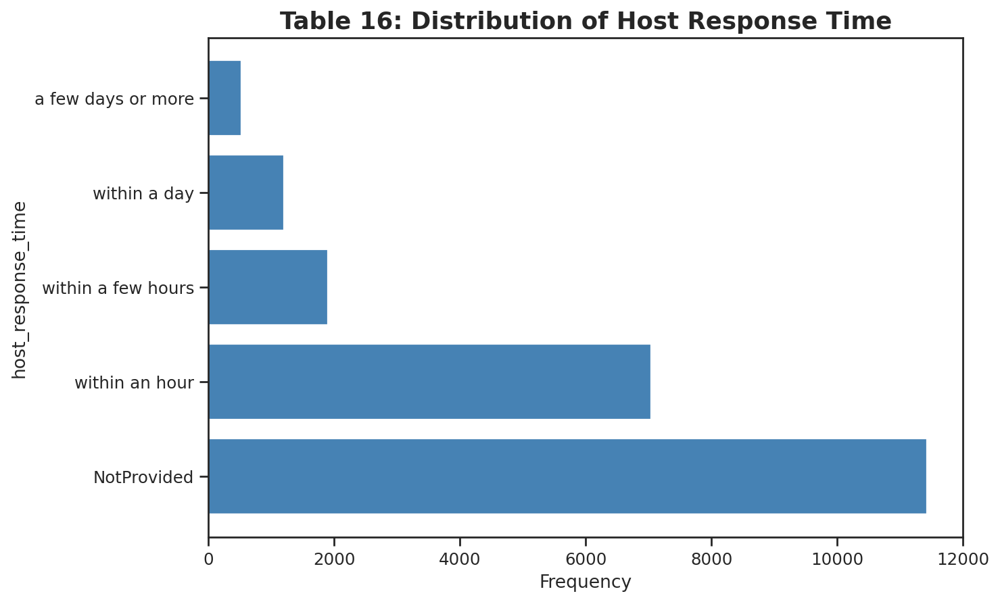

In [ ]:
# Calculate the frequency of each category
category_counts = data['host_response_time'].value_counts()

# Plot the histogram
plt.barh(category_counts.index, category_counts.values,color='steelblue')
plt.xlabel('Frequency')
plt.ylabel('host_response_time')
plt.title('Table 16: Distribution of Host Response Time', fontsize=16, fontweight='bold')
plt.show()

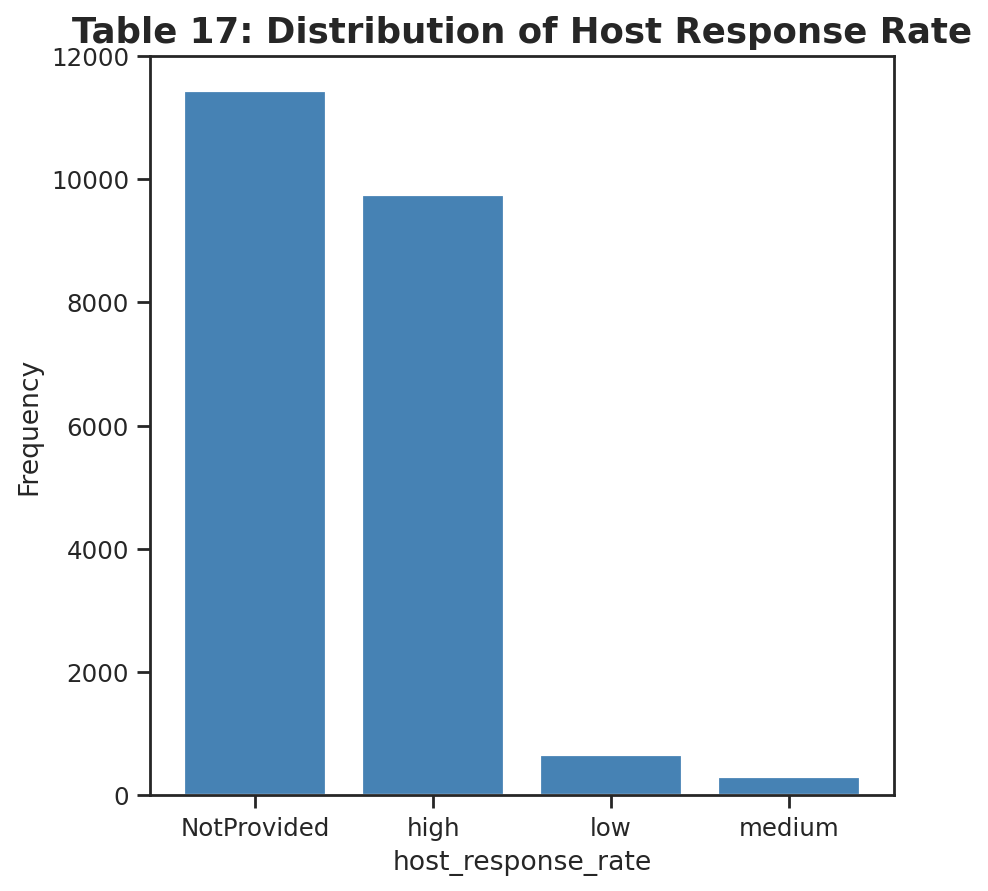

In [ ]:
# Calculate the frequency of each category
category_counts = data['host_response_rate'].value_counts()

# Plot the histogram
plt.figure(figsize=(6, 6))
plt.bar(category_counts.index, category_counts.values,color='steelblue')
plt.xlabel('host_response_rate')
plt.ylabel('Frequency')
plt.title('Table 17: Distribution of Host Response Rate', fontsize=16, fontweight='bold')
plt.show()

## License

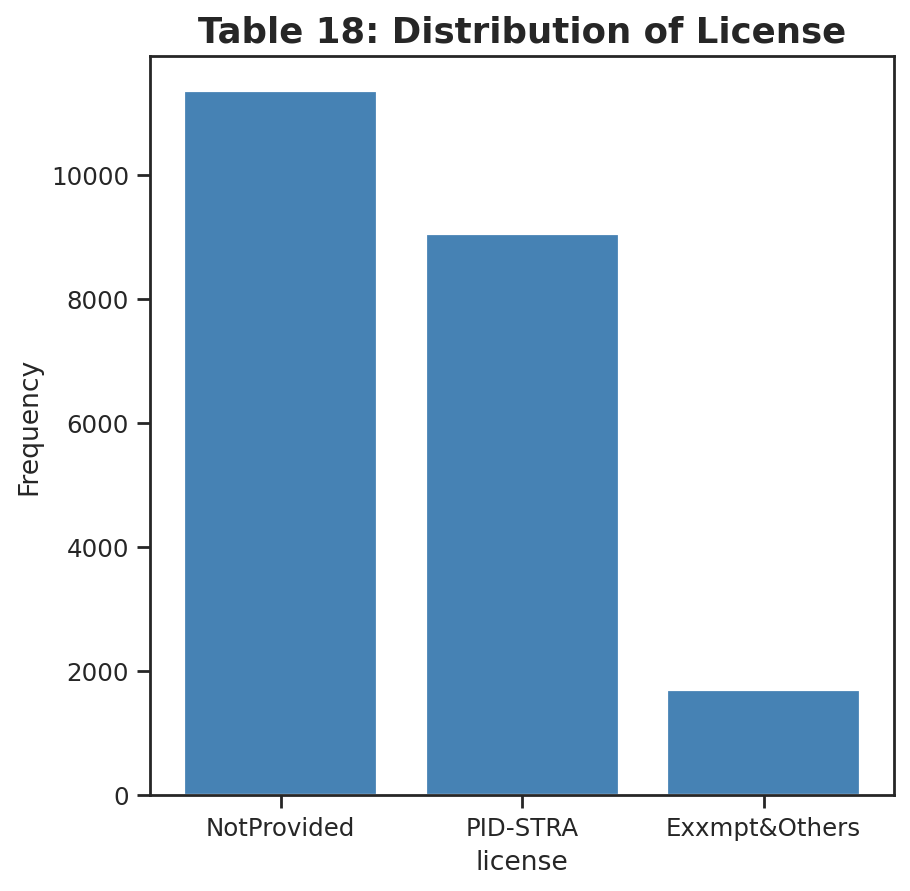

In [ ]:

# Calculate the frequency of each category
category_counts = data['license'].value_counts()

# Plot the histogram
plt.figure(figsize=(6, 6))
plt.bar(category_counts.index, category_counts.values, color='steelblue')
plt.xlabel('license')
plt.ylabel('Frequency')
plt.title('Table 18: Distribution of License', fontsize=16, fontweight='bold')
plt.show()

## Score

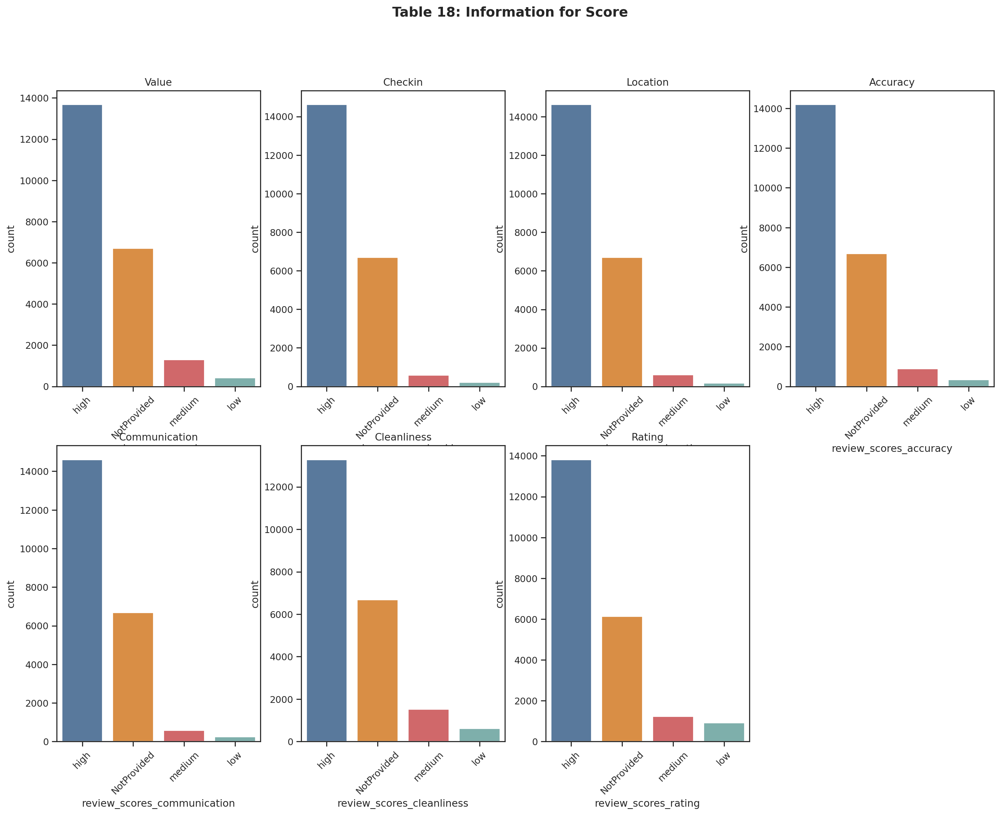

In [ ]:
plt.figure(figsize=(20,14))
plt.suptitle('Table 26: Information for Score', size = 16, fontweight='bold')

plt.subplot(241)
sns.countplot(x='review_scores_value', data=data)
plt.title('Value')
plt.xticks(rotation=45)

plt.subplot (242)
sns.countplot(x='review_scores_checkin', data=data)
plt.title('Checkin')
plt.xticks(rotation=45)

plt.subplot (243)
sns.countplot(x='review_scores_location', data=data)
plt.title('Location')
plt.xticks(rotation=45)

plt.subplot (244)
sns.countplot(x='review_scores_accuracy', data=data)
plt.title('Accuracy')
plt.xticks(rotation=45)

plt.subplot(245)
sns.countplot(x='review_scores_communication', data=data)
plt.title('Communication')
plt.xticks(rotation=45)

plt.subplot(246)
sns.countplot(x='review_scores_cleanliness', data=data)
plt.title('Cleanliness')
plt.xticks(rotation=45)

plt.subplot(247)
sns.countplot(x='review_scores_rating', data=data)
plt.title('Rating')
plt.xticks(rotation=45)

plt.show()

## Number of reviews

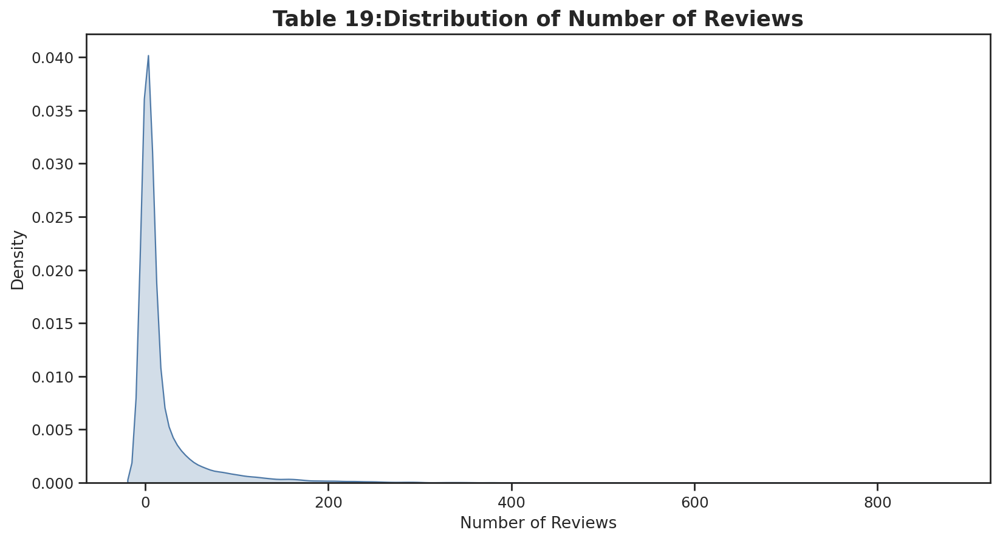

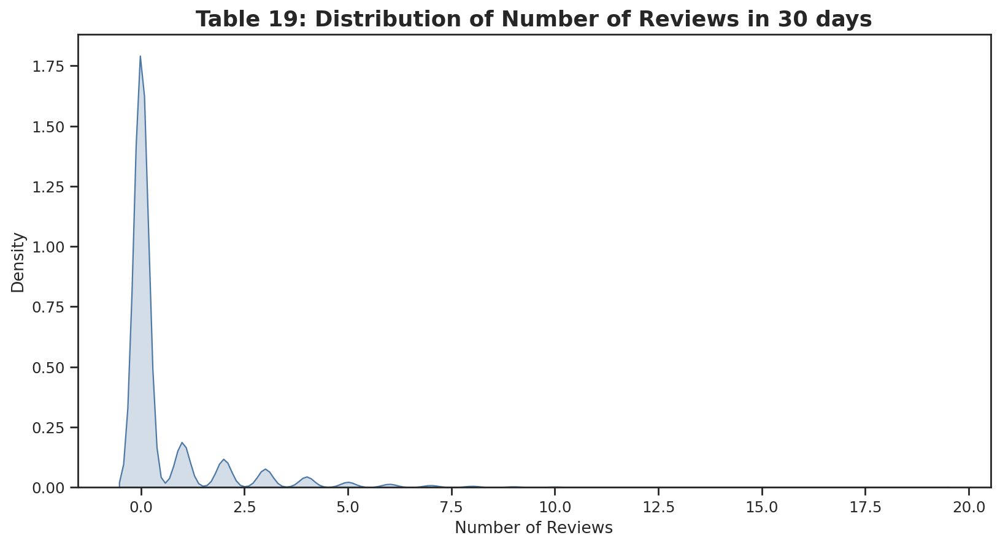

In [ ]:
plt.figure(figsize=(12, 6))
sns.kdeplot(data['number_of_reviews'], shade=True)
plt.xlabel('Number of Reviews')
plt.ylabel('Density')
plt.title('Table 19:Distribution of Number of Reviews',fontsize=16, fontweight='bold')
plt.show()

plt.figure(figsize=(12, 6))
sns.kdeplot(data['number_of_reviews_l30d'], shade=True)
plt.xlabel('Number of Reviews')
plt.ylabel('Density')
plt.title('Table 19: Distribution of Number of Reviews in 30 days',fontsize=16, fontweight='bold')
plt.show()

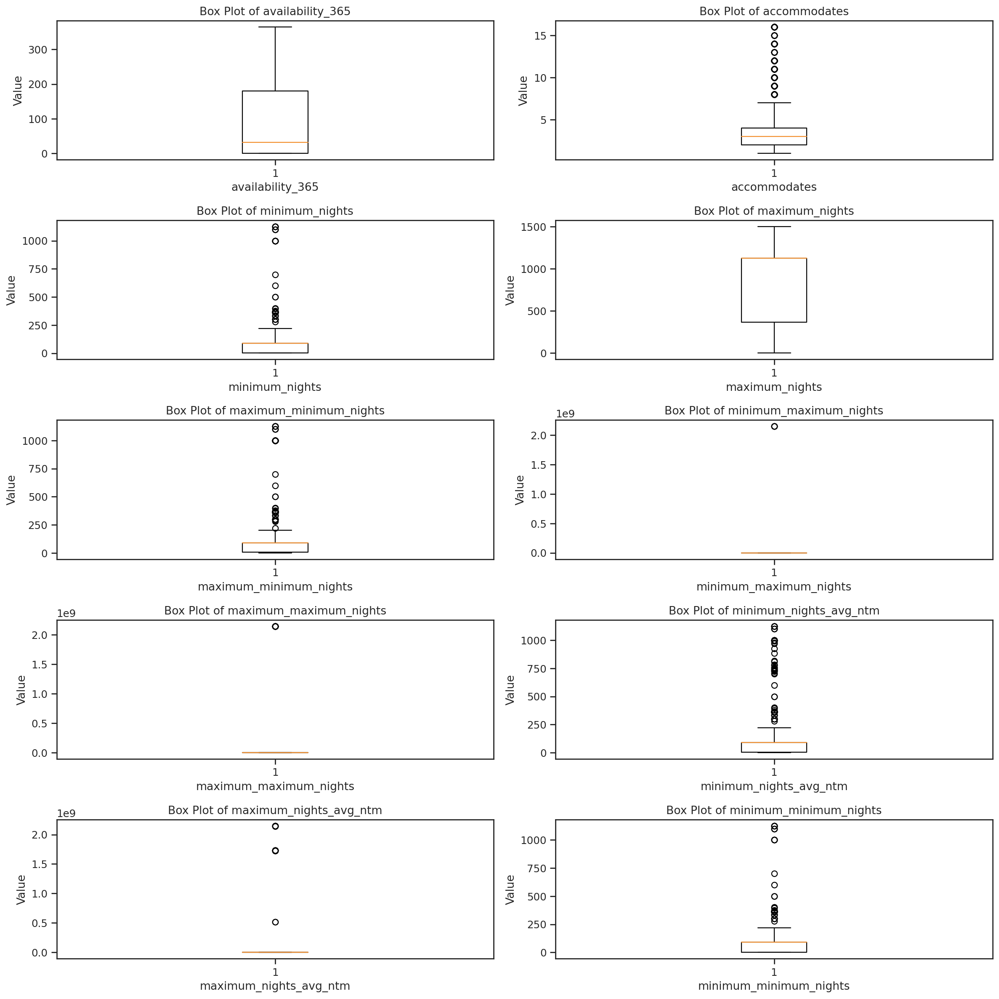

<Figure size 720x480 with 0 Axes>

In [ ]:
# Create a list
var_numerical= [
    'availability_365', 'accommodates', 'minimum_nights', 'maximum_nights',
    'maximum_minimum_nights', 'minimum_maximum_nights', 'maximum_maximum_nights',
    'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm','minimum_minimum_nights'
]

# Create a subplot grid
fig, axes = plt.subplots(5, 2, figsize=(15, 15))

# Flatten the axes array to iterate through the subplots
axes = axes.flatten()

# Generate box plots
for i, var in enumerate(var_numerical):
    axes[i].boxplot(data[var])
    axes[i].set_title(f'Box Plot of {var}')
    axes[i].set_xlabel(var)
    axes[i].set_ylabel('Value')

# Hide any unused subplots
for j in range(len(var_numerical), 5 * 2):
    fig.delaxes(axes[j])

# Adjust the spacing between subplots
fig.tight_layout()
plt.show()
plt.savefig("boxplot")

# Part 4: Five Model

In [ ]:
object_variables = X_train.select_dtypes(include = 'object').columns.tolist()

In [ ]:
from category_encoders.glmm import GLMMEncoder
for column in object_variables:
    encoder = GLMMEncoder().fit(X_train[[column]], y_train)
    X_train[column] = encoder.transform(X_train[column])
    X_valid[column] = encoder.transform(X_valid[column])

In [ ]:
# Apply log transformation to y_train
y_train = np.log(y_train)

# Apply log transformation to y_valid
y_valid = np.log(y_valid)

结合price的分布解释

In [ ]:
train_data = lgb.Dataset(X_train, label=y_train)
#valid_data = lgb.Dataset(X_valid, y_valid, reference = train_data)

## Model 1: Gradient Boosting

### Hyperparameter tuning and Final model building

In [ ]:
np.random.seed(1)
from optuna.samplers import TPESampler

def objective(trial):

# Set the hyperprameter range
    params = {
    'objective': 'regression',
    'boosting_type': 'gbdt',
    'learning_rate': 0.01,
    'num_leaves': trial.suggest_int('num_leaves', 2, 64),
    'lambda_l1': trial.suggest_loguniform('lambda_l1',  1e-8, 10),
    'lambda_l2': trial.suggest_loguniform('lambda_l2',  1e-8, 10),
    'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.5, 1.0),
    'bagging_freq': trial.suggest_int('bagging_freq', 1, 10),
    'feature_fraction':  trial.suggest_uniform('feature_fraction', 0.5, 1.0),
    'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 1, 128),
    'feature_pre_filter': False,
    'verbosity': -1,
     }

    # CV
    history = lgb.cv(params, train_data, num_boost_round = 5000,
                 nfold = 5, stratified = False, early_stopping_rounds = 50, verbose_eval=0)

    # Store the hyperparameter
    trial.set_user_attr('params', params)

    # Early stopping to prevent from the overfitting
    trial.set_user_attr('num_boost_round', len(history['l2-mean']))

    return history['l2-mean'][-1] # CV error for the best trial

sampler = TPESampler(seed = 42)
study = optuna.create_study(direction='minimize', sampler=sampler)
study.optimize(objective, n_trials=500, timeout = 120)

[I 2023-05-26 12:47:31,513] A new study created in memory with name: no-name-4eebb978-dc4f-417c-b6c2-b948d70a30c5
[I 2023-05-26 12:48:24,097] Trial 0 finished with value: 0.19813658268897533 and parameters: {'num_leaves': 25, 'lambda_l1': 3.6010467344475403, 'lambda_l2': 0.038720902953704193, 'bagging_fraction': 0.7993292420985183, 'bagging_freq': 2, 'feature_fraction': 0.5779972601681014, 'min_data_in_leaf': 8}. Best is trial 0 with value: 0.19813658268897533.
[I 2023-05-26 12:48:49,447] Trial 1 finished with value: 0.2022334226228907 and parameters: {'num_leaves': 56, 'lambda_l1': 0.002570603566117598, 'lambda_l2': 0.023585940584142682, 'bagging_fraction': 0.5102922471479012, 'bagging_freq': 10, 'feature_fraction': 0.9162213204002109, 'min_data_in_leaf': 28}. Best is trial 0 with value: 0.19813658268897533.
[I 2023-05-26 12:49:26,680] Trial 2 finished with value: 0.20135401254499277 and parameters: {'num_leaves': 13, 'lambda_l1': 4.4734294104626844e-07, 'lambda_l2': 5.472429642032198

In [ ]:
# Create a dataframe to store the hyperparameter's MSE
df_results = pd.DataFrame(columns=['num_leaves', 'lambda_l1', 'lambda_l2',
                                   'bagging_fraction', 'bagging_freq',
                                   'feature_fraction', 'min_data_in_leaf', 'MSE'])

# Record the MSE of each trail and the combination of the hyperparmeterd
for i, trial in enumerate(study.trials):
    params = trial.params
    mse = trial.value  # Use the original MSE value
    df_results = df_results.append({'num_leaves': params['num_leaves'],
                                    'lambda_l1': params['lambda_l1'],
                                    'lambda_l2': params['lambda_l2'],
                                    'bagging_fraction': params['bagging_fraction'],
                                    'bagging_freq': params['bagging_freq'],
                                    'feature_fraction': params['feature_fraction'],
                                    'min_data_in_leaf': params['min_data_in_leaf'],
                                    'MSE': mse}, ignore_index=True)

# See the MSE of each trial
df_results.index = ['Trial {}'.format(i ) for i in range(len(df_results))]

# show the dataframe
print("Optimization results of LightGBM")
df_results

Optimization results of LightGBM


,num_leaves,lambda_l1,lambda_l2,bagging_fraction,bagging_freq,feature_fraction,min_data_in_leaf,MSE
Trial 0,25.0,3.601047e+00,0.038721,0.799329,2.0,0.577997,8.0,0.198137
Trial 1,56.0,2.570604e-03,0.023586,0.510292,10.0,0.916221,28.0,0.202233
Trial 2,13.0,4.473429e-07,0.000005,0.762378,5.0,0.645615,79.0,0.201354
Trial 3,10.0,4.258943e-06,0.000020,0.728035,8.0,0.599837,66.0,0.200957


In [ ]:
# The best hyperparamter of the LGBM
lgbmParams = study.best_trial.user_attrs['params']
num_trees = study.best_trial.user_attrs['num_boost_round']

print(f'Number of boosting iterations: {num_trees} \n')

print('Best parameters:')
lgbmParams

Number of boosting iterations: 3286 

Best parameters:


{'objective': 'regression',
 'boosting_type': 'gbdt',
 'learning_rate': 0.01,
 'num_leaves': 25,
 'lambda_l1': 3.6010467344475403,
 'lambda_l2': 0.038720902953704193,
 'bagging_fraction': 0.7993292420985183,
 'bagging_freq': 2,
 'feature_fraction': 0.5779972601681014,
 'min_data_in_leaf': 8,
 'feature_pre_filter': False,
 'verbosity': -1}

In [ ]:
# Fit the final model
np.random.seed(2)
import lightgbm as lgb

lgbm = lgb.train(lgbmParams, train_data, num_boost_round = 5000, verbose_eval = False)

##Model 2: KNN regression

### Hyperparameter tuning and Final model building

In [ ]:
np.random.seed(3)
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import GridSearchCV

# Create a KNN regression model
knn = KNeighborsRegressor()

# The hyperparameter range to search
param_grid = {
    'n_neighbors': [1, 3, 5],
    'metric': ['euclidean', 'manhattan']
}

# Grid search cv object
grid_search = GridSearchCV(estimator=knn, param_grid=param_grid, cv=5)

# grdisearch fit
grid_search.fit(X_train, y_train)

# Grid search result
results = grid_search.cv_results_
best_knn_params = grid_search.best_params_

# The hyperparameter combination and their MSE
param_combinations = results['params']
mean_squared_errors = results['mean_test_score']

knn = grid_search.best_estimator_

# Fit the final model
knn.fit(X_train, y_train)


KNeighborsRegressor(metric='manhattan')

In [ ]:
# Create a dataframe to store the hyperparameter list
df_results = pd.DataFrame(index=['n_neighbors:1', 'n_neighbors:3', 'n_neighbors:5'], columns=param_grid['metric'])

# MSE of each hyperparameter combination
for params, mse in zip(param_combinations, mean_squared_errors):
    n_neighbors = params['n_neighbors']
    metric = params['metric']
    df_results.loc['n_neighbors:' + str(n_neighbors), metric] = mse

# Show the data frame
print("MSE of each hyperparameter combination of KNN")
df_results

MSE of each hyperparameter combination of KNN


,euclidean,manhattan
n_neighbors:1,0.370868,0.391245
n_neighbors:3,0.543565,0.565589
n_neighbors:5,0.576233,0.600042


## Model 3: Elastic Net Linear regression

### Hyperparameter tuning and Final model building

In [ ]:
np.random.seed(4)
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import GridSearchCV

# the hyperparameter combination in the grid search
param_grid = {
    'alpha': [0.1, 1, 10],
    'l1_ratio': [0.1, 0.3, 0.5, 0.7, 0.9]
}

# build the model
elastic_net = ElasticNet()

#Gridsearch CV
grid_search = GridSearchCV(elastic_net, param_grid, cv=5)
grid_search.fit(X_train, y_train)
results = grid_search.cv_results_

# Get the best hyperparameteres
best_elastic_params = grid_search.best_params_
best_alpha = grid_search.best_params_['alpha']
best_l1_ratio = grid_search.best_params_['l1_ratio']
elastic_net = ElasticNet(alpha=best_alpha, l1_ratio=best_l1_ratio)
elastic_net.fit(X_train, y_train)

ElasticNet(alpha=0.1, l1_ratio=0.1)

In [ ]:
# Create a dataframe to store the hyperparmeter combination
df_results = pd.DataFrame(index=[f'alpha:{alpha}' for alpha in param_grid['alpha']],
                          columns=[f'l1_ratio:{l1_ratio}' for l1_ratio in param_grid['l1_ratio']])

# Create the dataframe to store the perofrmance of the hyperparameter combination
for params, mse in zip(results['params'], results['mean_test_score']):
    alpha = params['alpha']
    l1_ratio = params['l1_ratio']
    df_results.loc[f'alpha:{alpha}', f'l1_ratio:{l1_ratio}'] = mse

# Show the dataframe
print("MSE of each hyperparameter combination of ElasticNet")
df_results






MSE of each hyperparameter combination of ElasticNet


,l1_ratio:0.1,l1_ratio:0.3,l1_ratio:0.5,l1_ratio:0.7,l1_ratio:0.9
alpha:0.1,0.683838,0.680759,0.676378,0.673075,0.671644
alpha:1,0.662135,0.630575,0.607347,0.606456,0.605491
alpha:10,0.605245,0.598959,0.592968,0.584107,0.573844


## Model 4: Random Forest

### Hyperparameter tuning and Final model building

In [ ]:
np.random.seed(5)
import optuna
from optuna.samplers import TPESampler
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor
import numpy as np

# hyperparameters tuned and the model structure built using the hyperparameters
def objective(trial):
    criterion = trial.suggest_categorical('criterion', ['squared_error'])
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 20)
    max_features = trial.suggest_int('max_features', 1, 20)

    model = RandomForestRegressor(n_estimators=100,
                                  criterion=criterion,
                                  max_features=max_features,
                                  min_samples_leaf=min_samples_leaf,
                                  random_state=1)

    scores = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
    loss = -np.mean(scores)

    return loss

sampler = TPESampler(seed=42)

# Create the optuna object for optimization by minimization the MSE
study = optuna.create_study(direction='minimize', sampler=sampler)

# optimization of the model
study.optimize(objective, n_trials=500, timeout=120)

[I 2023-05-26 12:51:09,936] A new study created in memory with name: no-name-51851f51-11ff-45ad-a95d-d7c5581f9182
[I 2023-05-26 12:51:30,322] Trial 0 finished with value: 0.2200195335655645 and parameters: {'criterion': 'squared_error', 'min_samples_leaf': 8, 'max_features': 20}. Best is trial 0 with value: 0.2200195335655645.
[I 2023-05-26 12:51:42,236] Trial 1 finished with value: 0.22829564949224618 and parameters: {'criterion': 'squared_error', 'min_samples_leaf': 15, 'max_features': 12}. Best is trial 0 with value: 0.2200195335655645.
[I 2023-05-26 12:51:48,971] Trial 2 finished with value: 0.2279760925471838 and parameters: {'criterion': 'squared_error', 'min_samples_leaf': 4, 'max_features': 4}. Best is trial 0 with value: 0.2200195335655645.
[I 2023-05-26 12:52:14,057] Trial 3 finished with value: 0.21289534334762578 and parameters: {'criterion': 'squared_error', 'min_samples_leaf': 2, 'max_features': 18}. Best is trial 3 with value: 0.21289534334762578.
[I 2023-05-26 12:52:28,

In [ ]:
# Create a dataframe to store the performance of each hyperparameter combination
df_results = pd.DataFrame(columns=['criterion', 'min_samples_leaf', 'max_features', 'MSE'])

# MSE of each trail
for i, trial in enumerate(study.trials):
    params = trial.params
    mse = -trial.value  # MSE needed to be positive
    df_results = df_results.append({'criterion': params['criterion'],
                                    'min_samples_leaf': params['min_samples_leaf'],
                                    'max_features': params['max_features'],
                                    'MSE': -mse}, ignore_index=True)

# Add trial names as 'Trial 1', 'Trial 2', etc.
df_results.index = ['Trial {}'.format(i ) for i in range(len(df_results))]

# Display the dataframe
print("Optimization results of RandomForestRegressor")
df_results



Optimization results of RandomForestRegressor


,criterion,min_samples_leaf,max_features,MSE
Trial 0,squared_error,8,20,0.220020
Trial 1,squared_error,15,12,0.228296
Trial 2,squared_error,4,4,0.227976
Trial 3,squared_error,2,18,0.212895
Trial 4,squared_error,13,15,0.226594
Trial 5,squared_error,1,20,0.213161
Trial 6,squared_error,17,5,0.242744
Trial 7,squared_error,4,4,0.227976


In [ ]:
# show the best hyperparameter combination of the rf model
rfParams = study.best_params
rfParams

{'criterion': 'squared_error', 'min_samples_leaf': 2, 'max_features': 18}

In [ ]:
np.random.seed(6)
from sklearn.ensemble import RandomForestRegressor

#Build the RF model using the best hyperparmeters
rf = RandomForestRegressor(n_estimators=100, **rfParams)
rf.fit(X_train, y_train)

#=2000

RandomForestRegressor(max_features=18, min_samples_leaf=2)

## Model 5: Stacked model

### Hyperparameter tuning and Final model building

In [ ]:
from sklearn.ensemble import StackingRegressor
from lightgbm import LGBMRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import GradientBoostingRegressor

np.random.seed(7)
import pandas as pd
import warnings

warnings.simplefilter("ignore")

# Final estimators list
final_estimators = [
    LGBMRegressor(),
    XGBRegressor(),
    GradientBoostingRegressor()
]

# Two base model which is trained using the best hyperparameters
lgb_model = LGBMRegressor(**lgbmParams)
rf_model = RandomForestRegressor(n_estimators=100, **rfParams)


estimators = [('lgb', lgb_model), ('rf', rf_model)]

# Create a dataframe to store the different final estimaors' cv scores
stack_result = pd.DataFrame(columns=['Final_estimator', 'Cross-Validation Score'])

# Measure the MSE of each final estimator using cv
for estimator in final_estimators:
    stack = StackingRegressor(estimators=estimators, final_estimator=estimator)
    scores = cross_val_score(stack, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
    mean_score = -scores.mean()  # MSE score needed to be possitive
    stack_result = stack_result.append({'Final_estimator': estimator.__class__.__name__, 'Cross-Validation Score': mean_score}, ignore_index=True)

# Adjust the index
stack_result.reset_index(drop=True, inplace=True)


[LightGBM] [Warning] feature_fraction is set=0.5779972601681014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5779972601681014
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] lambda_l2 is set=0.038720902953704193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.038720902953704193
[LightGBM] [Warning] bagging_fraction is set=0.7993292420985183, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7993292420985183
[LightGBM] [Warning] lambda_l1 is set=3.6010467344475403, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6010467344475403
[LightGBM] [Warning] feature_fraction is set=0.5779972601681014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5779972601681014
[LightGBM] [Warning] bagging_freq is set=2, su

In [ ]:
np.random.seed(8)
# Choose the best model based on the cv scores
best_estimator_idx = stack_result['Cross-Validation Score'].idxmin()
best_final_estimator = final_estimators[best_estimator_idx]

# Build the stacked model using the best hyperparameter combination
stack = StackingRegressor(estimators=estimators, final_estimator=best_final_estimator)
stack.fit(X_train, y_train)

[LightGBM] [Warning] feature_fraction is set=0.5779972601681014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5779972601681014
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] lambda_l2 is set=0.038720902953704193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.038720902953704193
[LightGBM] [Warning] bagging_fraction is set=0.7993292420985183, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7993292420985183
[LightGBM] [Warning] lambda_l1 is set=3.6010467344475403, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6010467344475403
[LightGBM] [Warning] feature_fraction is set=0.5779972601681014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5779972601681014
[LightGBM] [Warning] bagging_freq is set=2, su

StackingRegressor(estimators=[('lgb',
                               LGBMRegressor(bagging_fraction=0.7993292420985183,
                                             bagging_freq=2,
                                             feature_fraction=0.5779972601681014,
                                             feature_pre_filter=False,
                                             lambda_l1=3.6010467344475403,
                                             lambda_l2=0.038720902953704193,
                                             learning_rate=0.01,
                                             min_data_in_leaf=8, num_leaves=25,
                                             objective='regression',
                                             verbosity=-1)),
                              ('rf',
                               RandomForestRegressor(max_features=18,
                                                     min_samples_leaf=2))],
                  final_estimator=LGBMRegressor())

In [ ]:
# Show each model's CV score for the stacked model
print("CV Score of each final estimator for the stacked model")
stack_result

CV Score of each final estimator for the stacked model


,Final_estimator,Cross-Validation Score
0,LGBMRegressor,0.217355
1,XGBRegressor,0.229135
2,GradientBoostingRegressor,0.218577


上面这个代码是stack model建模部分，不是调参

# Part 5: Model Selection

In [ ]:
# Model 1: Gradient Boosting measured by Ajdusted R2 and R2
from sklearn.metrics import mean_squared_error, r2_score,  mean_absolute_error
y_pred = lgbm.predict(X_valid)
R_Squared= r2_score(y_valid, y_pred)
n = len(y_valid)  # Number of samples
p = X_valid.shape[1]  # Number of features
adjusted_R_squared = 1 - (1 - R_Squared) * (n - 1) / (n - p - 1)
print("Adjusted R-Squared is", adjusted_R_squared)
print("R_Squared is",R_Squared)


Adjusted R-Squared is 0.7580133051965673
R_Squared is 0.7597287463211165


In [ ]:
# Model 2: Elastic Net Linear regression measured by Ajdusted R2 and R2
from sklearn.metrics import mean_squared_error, r2_score,  mean_absolute_error
y_pred = elastic_net.predict(X_valid)
n = len(y_valid)  # Number of samples
p = X_valid.shape[1]  # Number of features
R_Squared= r2_score(y_valid, y_pred)
adjusted_R_squared = 1 - (1 - R_Squared) * (n - 1) / (n - p - 1)
print("Adjusted R-Squared is", adjusted_R_squared)
print("R_Squared is",R_Squared)

Adjusted R-Squared is 0.6644744840444371
R_Squared is 0.6668530208845445


In [ ]:
# Model 3: Rndom Forest measured by Ajdusted R2 and R2
from sklearn.metrics import mean_squared_error, r2_score,  mean_absolute_error
y_pred = rf.predict(X_valid)
n = len(y_valid)  # Number of samples
p = X_valid.shape[1]  # Number of features
R_Squared= r2_score(y_valid, y_pred)
adjusted_R_squared = 1 - (1 - R_Squared) * (n - 1) / (n - p - 1)
print("Adjusted R-Squared is", adjusted_R_squared)
print("R_Squared is",R_Squared)

Adjusted R-Squared is 0.7471361572325144
R_Squared is 0.748928706344139


In [ ]:
# Model 4: Stacked model measured by Ajdusted R2 and R2
from sklearn.metrics import mean_squared_error, r2_score,  mean_absolute_error
y_pred = stack.predict(X_valid)
n = len(y_valid)  # Number of samples
p = X_valid.shape[1]  # Number of features
R_Squared= r2_score(y_valid, y_pred)
adjusted_R_squared = 1 - (1 - R_Squared) * (n - 1) / (n - p - 1)
print("Adjusted R-Squared is", adjusted_R_squared)
print("R_Squared is",R_Squared)

Adjusted R-Squared is 0.7404832092072874
R_Squared is 0.7423229209972206


In [ ]:
# Model 5: KNN Regression measured by Ajdusted R2 and R2
from sklearn.metrics import mean_squared_error, r2_score,  mean_absolute_error
y_pred = knn.predict(X_valid)
n = len(y_valid)  # Number of samples
p = X_valid.shape[1]  # Number of features
R_Squared= r2_score(y_valid, y_pred)
adjusted_R_squared = 1 - (1 - R_Squared) * (n - 1) / (n - p - 1)
print("Adjusted R-Squared is", adjusted_R_squared)
print("R_Squared is",R_Squared)

Adjusted R-Squared is 0.5772367827104561
R_Squared is 0.5802337466942582


In [ ]:
from sklearn.metrics import mean_squared_error, r2_score,  mean_absolute_error

# Create the data frame to store the model performance
columns=['Adjusted R-Squared', 'R-Squared', 'MSE']
rows=['KNN', 'Elastic Net Linear regression', 'Stacked model','Random Forest','LightGBM']
results = pd.DataFrame(0.0, columns=columns, index=rows)

# Store the model name
models = [knn,elastic_net,stack,rf,lgbm]

# Assign each model's accuracy as value of its column name
for i, model in enumerate(models):

    y_pred = model.predict(X_valid)
    results.iloc[i, 0] = 1 - (1 - r2_score(y_valid, y_pred)) * (n - 1) / (n - p - 1)
    results.iloc[i, 1] = r2_score(y_valid, y_pred)
    results.iloc[i, 2] = np.sqrt(mean_squared_error(y_valid, y_pred))

results





,Adjusted R-Squared,R-Squared,MSE
KNN,0.577237,0.580234,0.605103
Elastic Net Linear regression,0.664474,0.666853,0.539068
Stacked model,0.740483,0.742323,0.474093
Random Forest,0.747136,0.748929,0.467977
LightGBM,0.758013,0.759729,0.457801


# Part 6: Model Featrue Importance

In [ ]:
# Train the shap for the feature importance interpretation
import shap

explainer = shap.TreeExplainer(lgbm)
shap_values = explainer.shap_values(X_valid)

feature importance for the LGBM model


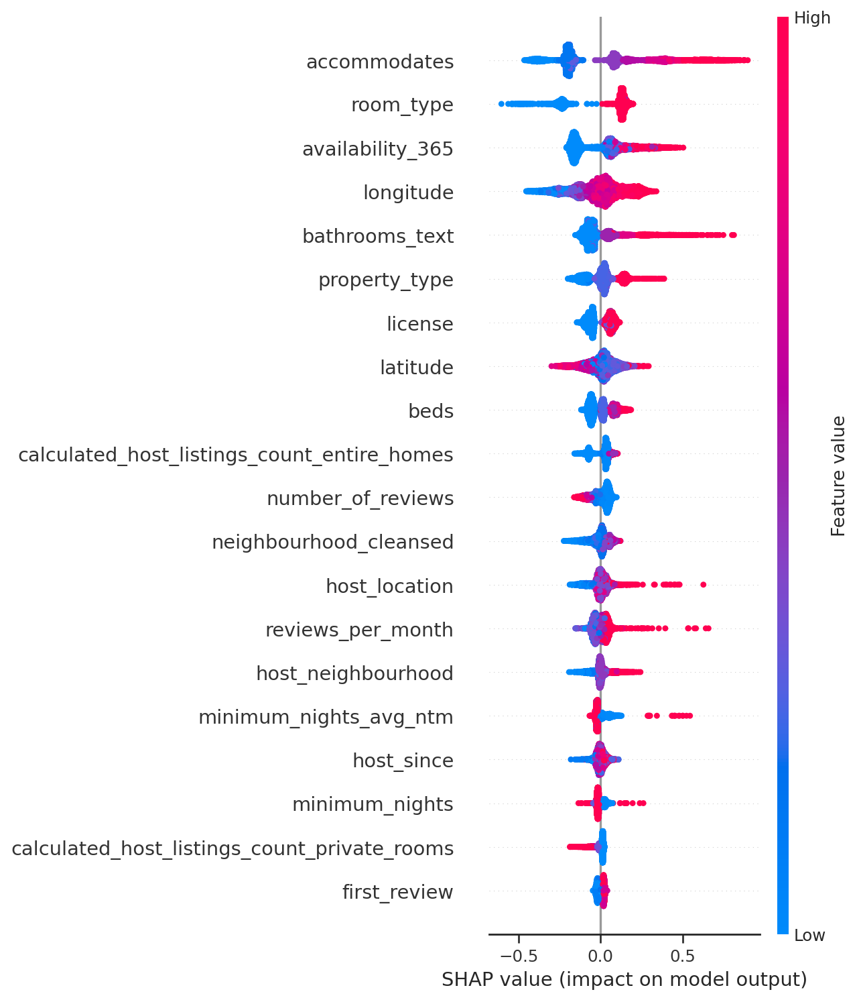

In [ ]:
# SHAP summary plot for the top 10 important features
print('feature importance for the LGBM model')
shap.summary_plot(shap_values, X_valid, max_display=20)

feature importance for the LGBM model


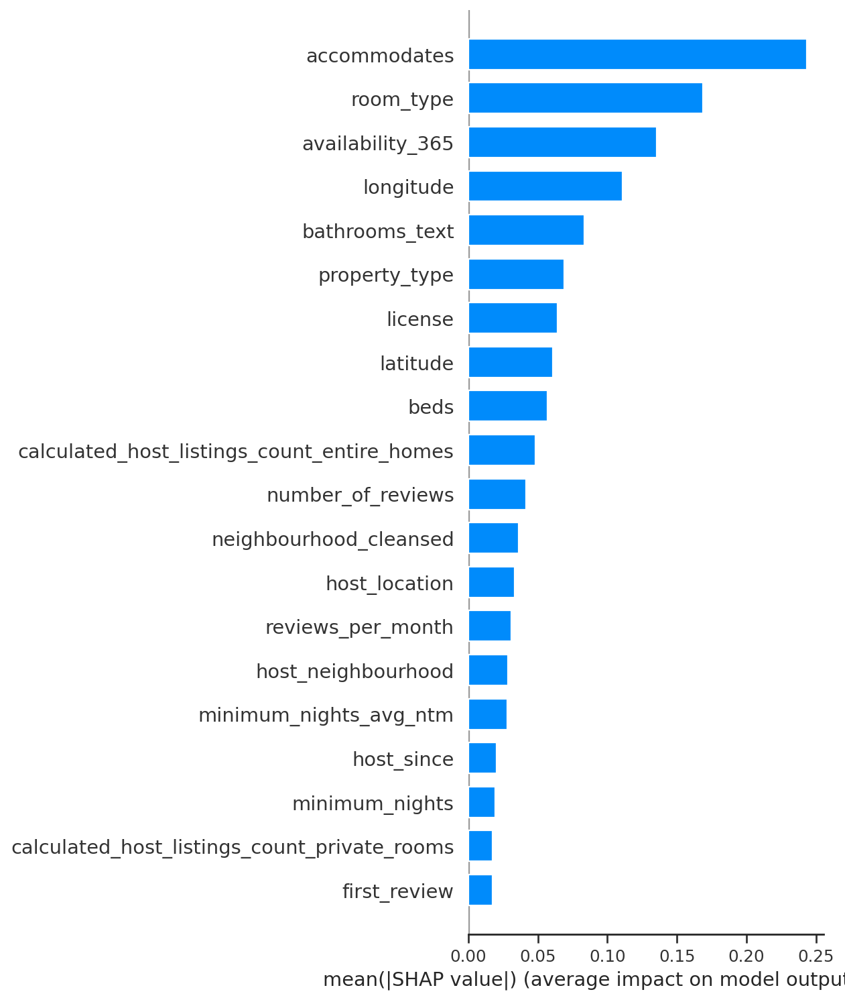

In [ ]:
# SHAP summary bar plot for the top 10 important features
print('feature importance for the LGBM model')
shap.summary_plot(shap_values, X_valid, plot_type='bar', max_display=20)

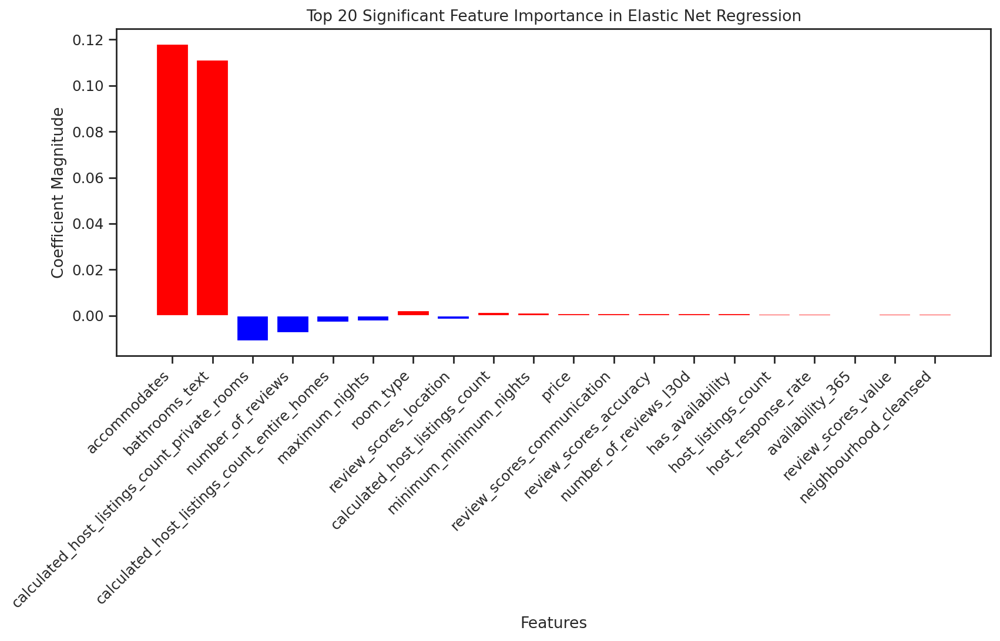

In [ ]:
# Extract the coefficients and make the column names to a list
coefficients = elastic_net.coef_
feature_names = data.columns.tolist()

# Select the non-zero and significant coefficients and store into list
significant_indices = np.nonzero(coefficients)[0]
significant_coefficients = coefficients[significant_indices]
significant_feature_names = [feature_names[i] for i in significant_indices]

# Sort the significant coefficients decreasingly
sorted_indices = np.argsort(np.abs(significant_coefficients))[::-1]
sorted_indices_top20 = sorted_indices[:20]
sorted_coefficients_top20 = significant_coefficients[sorted_indices_top20]
sorted_feature_names_top20 = [significant_feature_names[i] for i in sorted_indices_top20]

# Red for the possitive coefficients and Blue for the negative coefficients
colors = ['blue' if c < 0 else 'red' for c in sorted_coefficients_top20]

# Bar chart to show the top 20 important features
plt.figure(figsize=(12, 6))  # Increase the figure width to accommodate labels
plt.bar(sorted_feature_names_top20, sorted_coefficients_top20, color=colors)

# Set labels and titles
plt.xlabel('Features')
plt.ylabel('Coefficient Magnitude')
plt.title('Top 20 Significant Feature Importance in Elastic Net Regression')

# Rotate x-axis labels to avoid overlapping
plt.xticks(rotation=45, ha='right')  # Rotate labels by 45 degrees and align them to the right

# Aviod overlapping
plt.subplots_adjust(bottom=0.3)
plt.show()

# Part 7: Business Insights

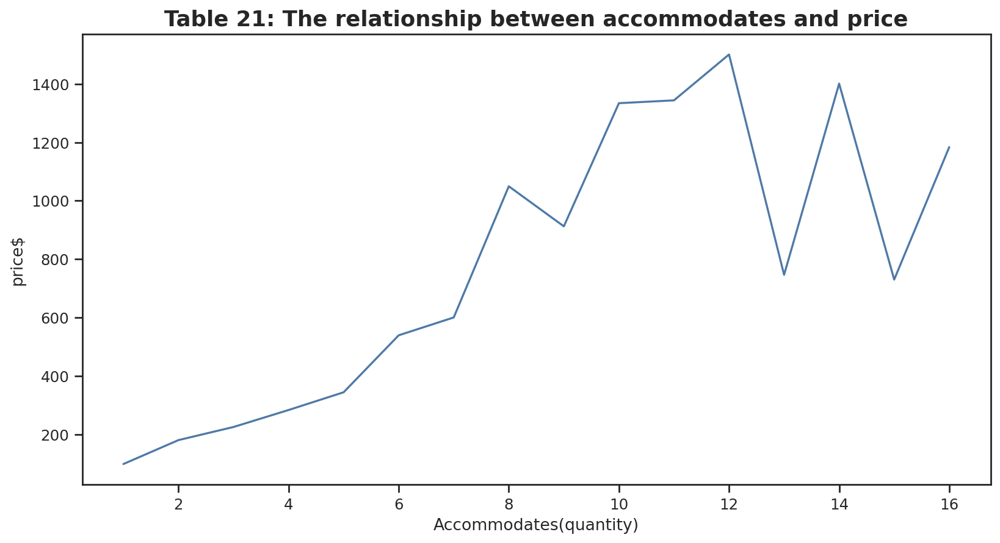

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot(np.sort(data['accommodates'].unique()),data.groupby('accommodates')['price'].mean())
plt.xlabel("Accommodates(quantity)")
plt.ylabel('price$')
plt.title('Table 21: The relationship between accommodates and price',fontsize=16, fontweight='bold')
plt.show()

In [ ]:
# Group the data by region and calculate the average price
avg_price = data.groupby('neighbourhood_cleansed')['price'].mean().reset_index()

# Create the map
map = folium.Map(location=[data['latitude'].mean(), data['longitude'].mean()], zoom_start=10)

# Set the color range for prices
price_range = (avg_price['price'].min(), avg_price['price'].max())

# Create a colormap function
colormap = linear.YlOrRd_09.scale(price_range[0], price_range[1])

# Iterate through the region data and add circle markers
colors = []
for index, row in avg_price.iterrows():
    color = colormap(row['price'])
    region_data = data[data['neighbourhood_cleansed'] == row['neighbourhood_cleansed']]
    for _, r in region_data.iterrows():
        folium.CircleMarker(
            location=[r['latitude'], r['longitude']],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            popup=f"Region: {r['neighbourhood_cleansed']}<br>Average Price: ${row['price']}"
        ).add_to(map)

# Create a legend for price ranges and colors
legend_html = '''
<div style="position: fixed;
     bottom: 50px; left: 50px; width: 200px; height: 120px;
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white;
     ">&nbsp; Price Legend (Avg price per night)<br>
     &nbsp; High &nbsp; <i class="fa fa-circle" style="color:#ff0000"></i> $700+<br>
     &nbsp; Medium &nbsp; <i class="fa fa-circle" style="color:#ffa500"></i> $350-$700<br>
     &nbsp; Low &nbsp; <i class="fa fa-circle" style="color:#ffff00"></i> $0-$350<br>
</div>
'''

map.get_root().html.add_child(folium.Element(legend_html))

#map.save('map.html')
display(map)

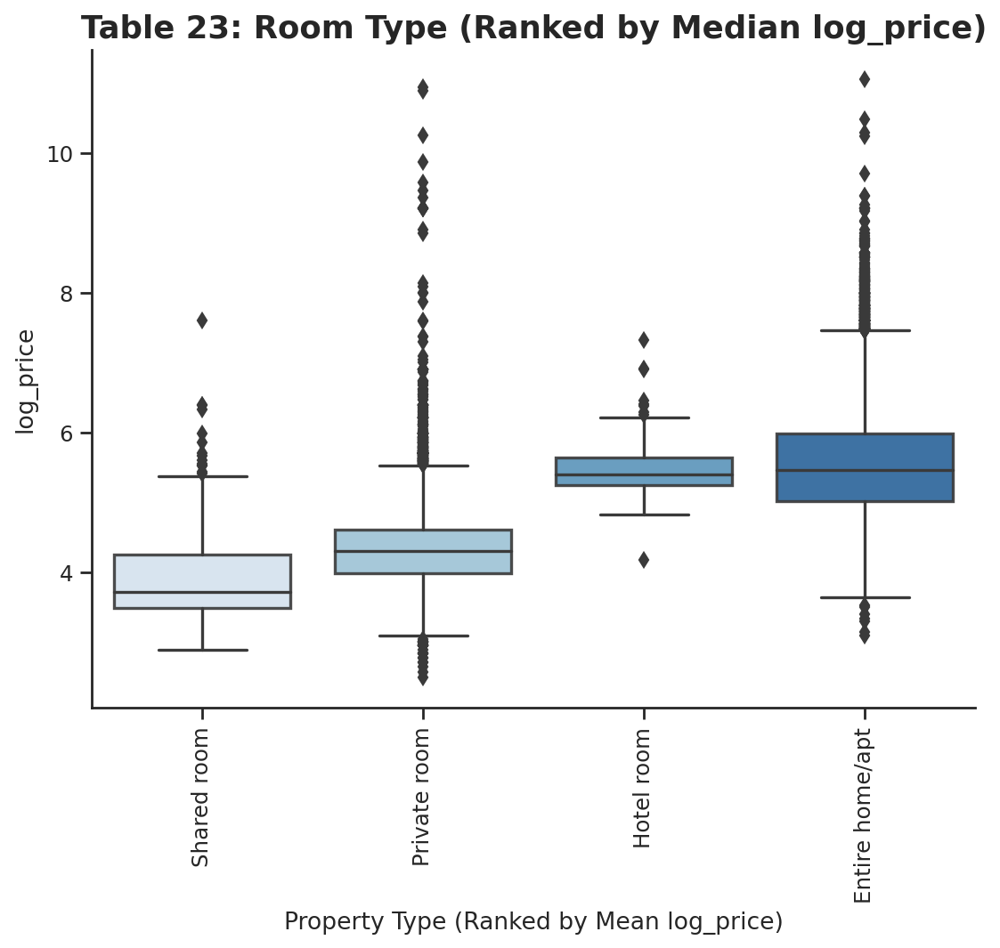

In [ ]:
# Create a new DataFrame to calculate the mean price per property type
mean_prices = data.groupby('room_type')['log_price'].mean().reset_index().sort_values('log_price')

plt.figure(figsize=(8, 6))
# Create the boxplot
sns.boxplot(x=data['room_type'], y=data['log_price'], boxprops=dict(alpha=0.9), palette='Blues', order=mean_prices['room_type'])

# Customize the x-axis labels
plt.xticks(rotation=90)  # Rotate the x-axis labels for better visibility
plt.xlabel('Property Type (Ranked by Mean log_price)')
plt.title('Table 23: Room Type (Ranked by Median log_price)',fontsize=16, fontweight='bold')

# Remove spines
sns.despine()

# Display the plot
plt.show()

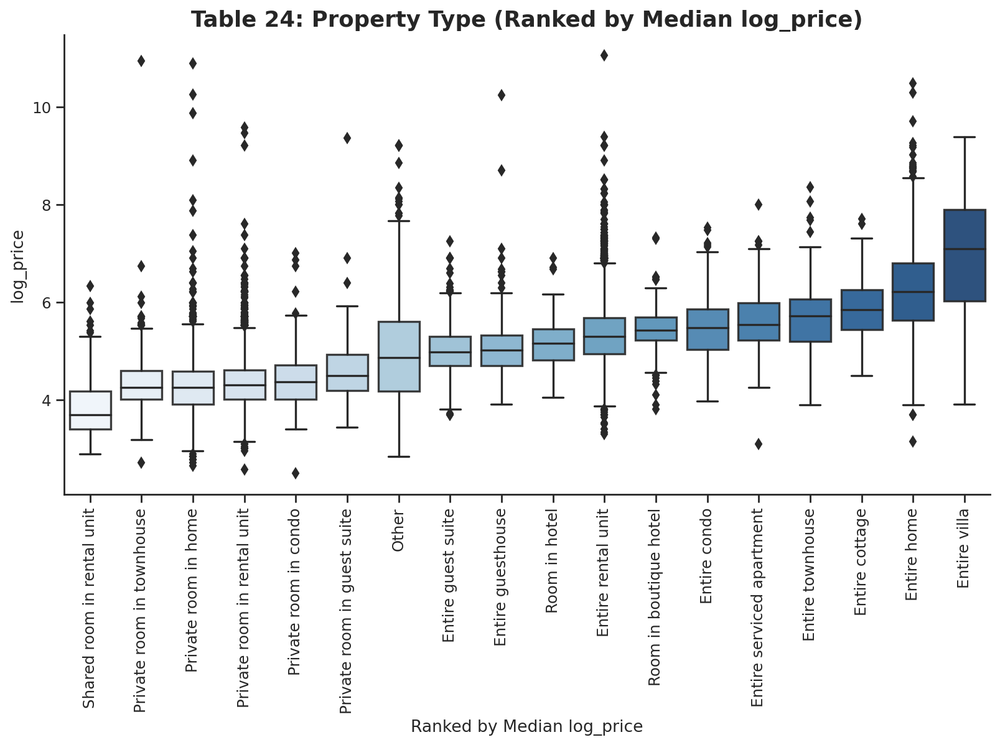

In [ ]:
# Create a new DataFrame to calculate the median price per property type
# Median Median Median!!!
median_prices = data.groupby('property_type')['log_price'].median().reset_index().sort_values('log_price')

plt.figure(figsize=(12, 6))
# Create the boxplot
sns.boxplot(x=data['property_type'], y=data['log_price'], boxprops=dict(alpha=0.9), palette='Blues', order=median_prices['property_type'])

# Customize the x-axis labels
plt.xticks(rotation=90)  # Rotate the x-axis labels for better visibility
plt.xlabel('Ranked by Median log_price')
plt.title('Table 24: Property Type (Ranked by Median log_price)',fontsize=16, fontweight='bold')
# Remove spines
sns.despine()

# Display the plot
plt.show()

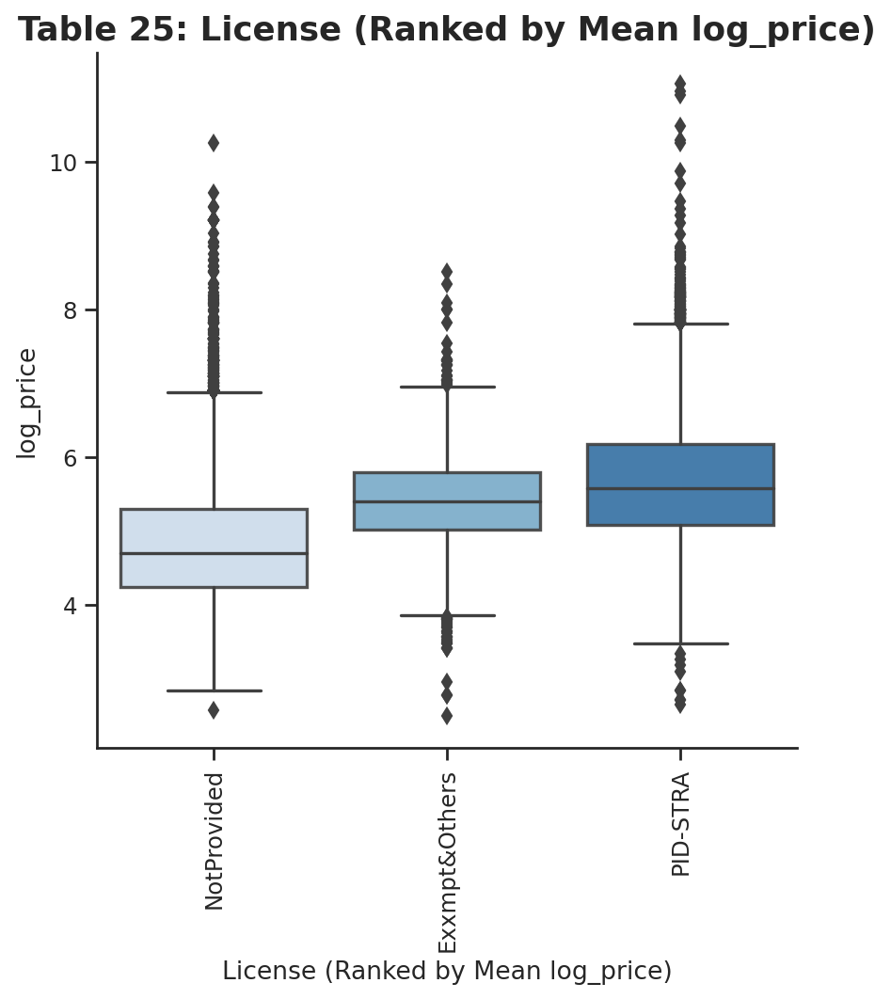

In [ ]:
# Create a new DataFrame to calculate the mean price per license category
mean_prices = data.groupby('license')['log_price'].mean().reset_index().sort_values('log_price')

plt.figure(figsize=(6, 6))
# Create the boxplot
sns.boxplot(x=data['license'], y=data['log_price'], boxprops=dict(alpha=0.9), palette='Blues', order=mean_prices['license'])

# Customize the x-axis labels
plt.xticks(rotation=90)  # Rotate the x-axis labels for better visibility
plt.xlabel('License (Ranked by Mean log_price)')
plt.title('Table 25: License (Ranked by Mean log_price)',fontsize=16, fontweight='bold')

# Remove spines
sns.despine()

# Display the plot
plt.show()